In [1]:
# importing python modules
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
from plotnine import * 
from scipy import stats
import seaborn as sns
from scipy.stats import spearmanr
from scipy.sparse import csr_matrix
import math
from scipy.stats import pearsonr
import glob
from venn import venn

%matplotlib inline
sc.logging.print_header()

scanpy==1.8.1 anndata==0.7.5 umap==0.5.1 numpy==1.21.0 scipy==1.6.2 pandas==1.2.3 scikit-learn==0.23.2 statsmodels==0.12.2 python-igraph==0.9.1 louvain==0.7.0 leidenalg==0.8.2 pynndescent==0.5.2


In [2]:
sc.settings.set_figure_params(dpi=80)

# Global Dataset

## loading the h5ad

In [3]:
adata = sc.read_h5ad('anndata/SS2_raw.h5ad')

In [4]:
adata

AnnData object with n_obs × n_vars = 7665 × 58962
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'dissociation_method', 'row', 'column', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'ranking_ID', 'batch'
    var: 'n_cells'

In [5]:
adata_copy = adata.copy()

In [6]:
adata_copy = adata_copy[~adata_copy.obs['plate_ID'].isin(['B008881','D088212'])]
adata_copy = adata_copy[adata_copy.obs['dissociation_method'] != 'sonication']

In [7]:
adata_copy

View of AnnData object with n_obs × n_vars = 6810 × 58962
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'dissociation_method', 'row', 'column', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'ranking_ID', 'batch'
    var: 'n_cells'

In [8]:
ercc_genes = [name for name in adata_copy.var_names if name.startswith('ERCC-')]
adata_copy = adata_copy[:,~adata_copy.var_names.isin(ercc_genes)]

In [9]:
adata_copy

View of AnnData object with n_obs × n_vars = 6810 × 58870
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'dissociation_method', 'row', 'column', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'ranking_ID', 'batch'
    var: 'n_cells'

Trying to set attribute `.uns` of view, copying.


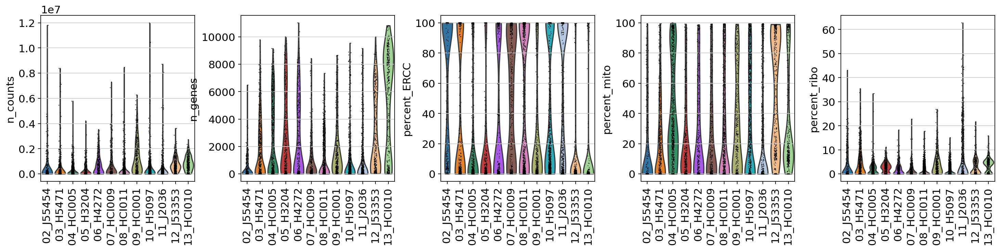

In [10]:
sc.pl.violin(adata_copy, ['n_counts','n_genes','percent_ERCC','percent_mito','percent_ribo'],groupby='ranking_ID',rotation=90)

## cell cycle genes

In [11]:
cell_cycle_genes = [x.strip() for x in open('files/regev_lab_cell_cycle_genes.txt')]

In [12]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

## embedding and clustering

### seurat V3 HVG w/ cell cycle regression

In [13]:
adata_copy

AnnData object with n_obs × n_vars = 6810 × 58870
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'dissociation_method', 'row', 'column', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'ranking_ID', 'batch'
    var: 'n_cells'
    uns: 'ranking_ID_colors'

In [14]:
adata_procssed = adata_copy.copy()
sc.pp.filter_cells(adata_procssed, min_counts=5000)
sc.pp.filter_cells(adata_procssed, min_genes=500)
sc.pp.filter_genes(adata_procssed, min_cells=5)

In [15]:
adata_procssed

AnnData object with n_obs × n_vars = 2823 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'dissociation_method', 'row', 'column', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'ranking_ID', 'batch'
    var: 'n_cells'
    uns: 'ranking_ID_colors'

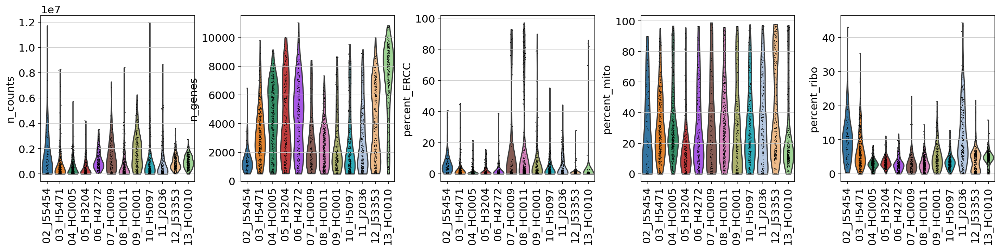

In [16]:
sc.pl.violin(adata_procssed, ['n_counts','n_genes','percent_ERCC','percent_mito','percent_ribo'],groupby='ranking_ID',rotation=90)

In [17]:
adata_procssed = adata_procssed[adata_procssed.obs.percent_mito < 50, :]
adata_procssed = adata_procssed[adata_procssed.obs.percent_ERCC < 20, :]

In [18]:
adata_procssed

View of AnnData object with n_obs × n_vars = 2090 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'dissociation_method', 'row', 'column', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'ranking_ID', 'batch'
    var: 'n_cells'
    uns: 'ranking_ID_colors'

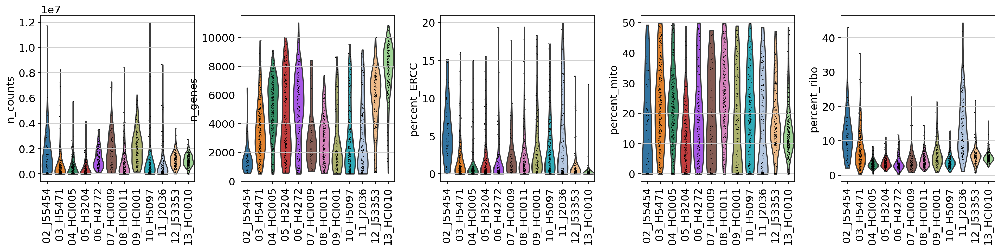

In [19]:
sc.pl.violin(adata_procssed, ['n_counts','n_genes','percent_ERCC','percent_mito','percent_ribo'],groupby='ranking_ID',rotation=90)

In [20]:
adata_procssed.layers['raw_counts'] = adata_procssed.X
sc.pp.highly_variable_genes(adata_procssed, n_top_genes=2000,flavor='seurat_v3')
sc.pp.normalize_per_cell(adata_procssed, counts_per_cell_after=1e4)
sc.pp.log1p(adata_procssed)
adata_procssed.layers['log1p'] = adata_procssed.X

In [21]:
adata_procssed.raw = adata_procssed
sc.tl.score_genes_cell_cycle(adata_procssed, s_genes=s_genes, g2m_genes=g2m_genes)
sc.pp.regress_out(adata_procssed, ['S_score', 'G2M_score'])
sc.pp.scale(adata_procssed,max_value=10)


... storing 'phase' as categorical


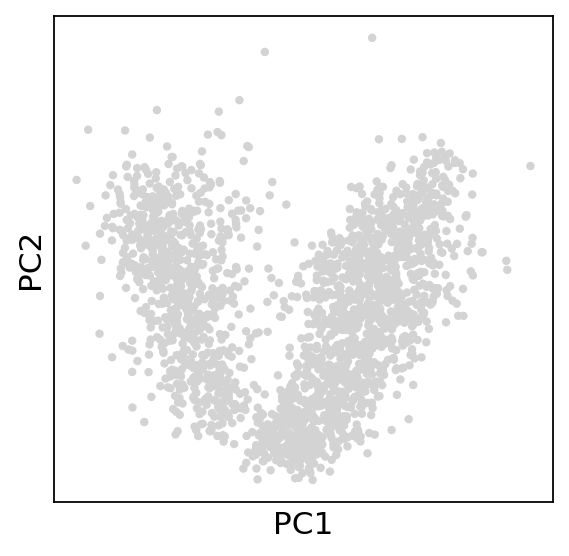

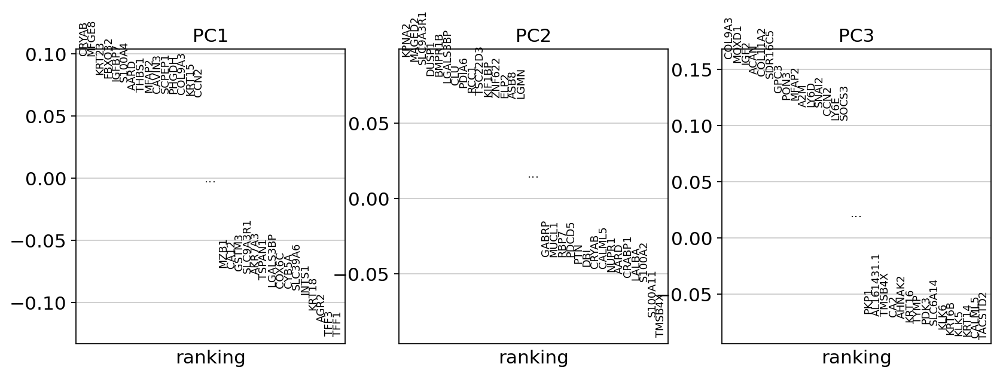

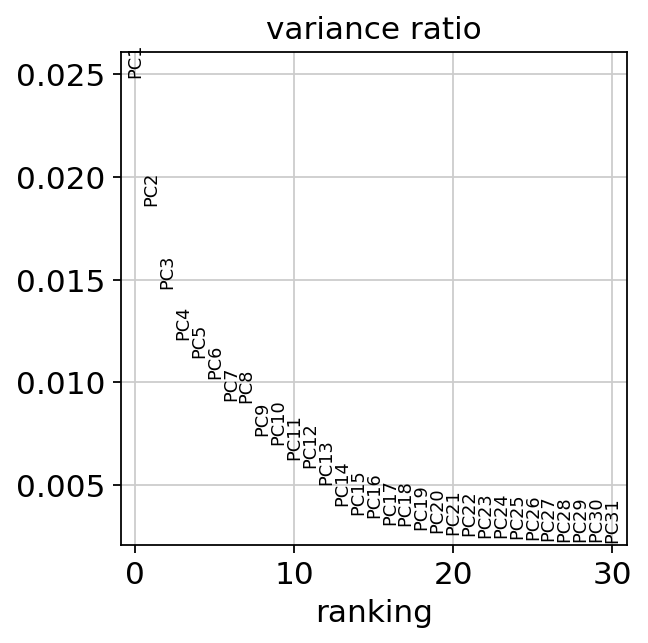

In [22]:
sc.tl.pca(adata_procssed, svd_solver='auto')
sc.pl.pca_overview(adata_procssed)

In [23]:
adata_procssed

AnnData object with n_obs × n_vars = 2090 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'dissociation_method', 'row', 'column', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'ranking_ID', 'batch', 'S_score', 'G2M_score', 'phase'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'

In [24]:
adata_procssed.uns['Tumor_ID_colors'] = ['#ffed6f','#ccebc5','#bc80bd','#b3de69','#fdb462','#fccde5',
                                     '#fb8072','#1598cc','#bebada','#8dd3c7','#80b1d3','#e8ee88']
adata_procssed.uns['ER_receptor_colors'] = ['#810f7c','#02818a']
adata_procssed.uns['intrinsic_BC_type_colors'] = ['#9ebcda','#8856a7']

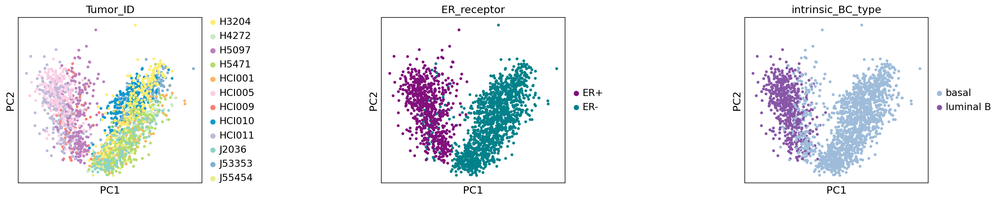

In [25]:
sc.pl.pca(adata_procssed, color=['Tumor_ID','ER_receptor','intrinsic_BC_type'], ncols=4, wspace=0.8)

In [26]:
sc.pp.neighbors(adata_procssed, n_neighbors=12, n_pcs=21)
sc.tl.louvain(adata_procssed, resolution = .5)
sc.tl.leiden(adata_procssed, resolution = .5)

In [27]:
sc.tl.umap(adata_procssed)

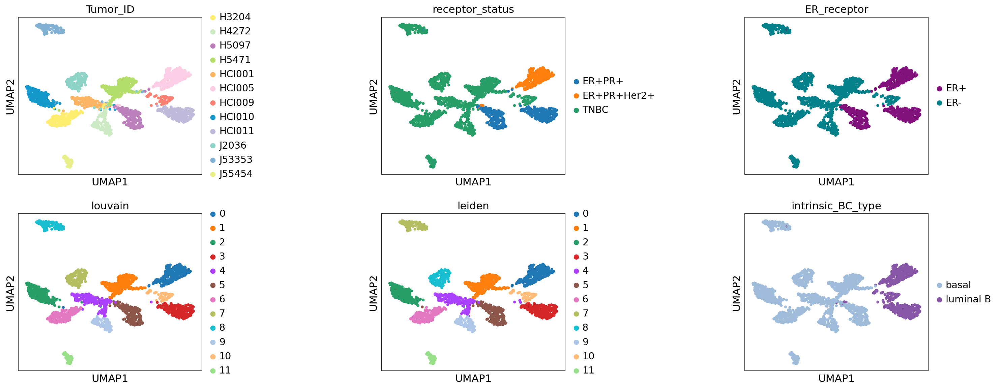

In [28]:
sc.pl.umap(adata_procssed, color=['Tumor_ID','receptor_status','ER_receptor','louvain','leiden','intrinsic_BC_type'], ncols=3, wspace=0.8)

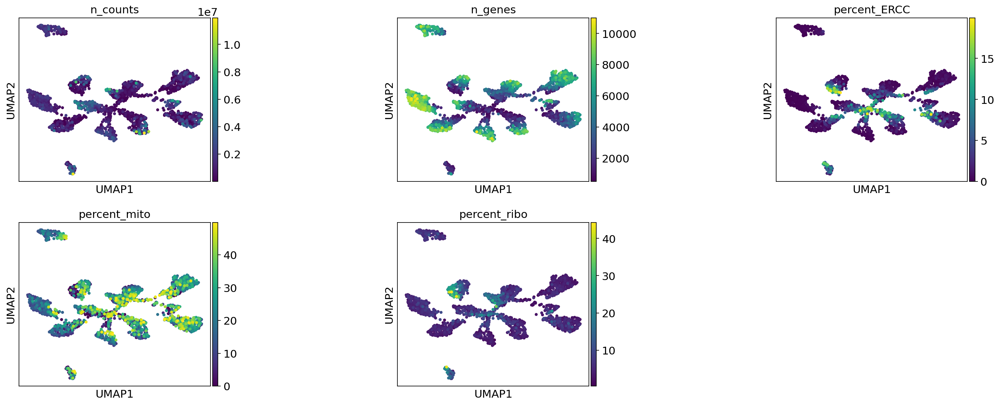

In [29]:
sc.pl.umap(adata_procssed, color=['n_counts','n_genes','percent_ERCC','percent_mito','percent_ribo'], ncols=3, wspace=0.8)

## Tan's EMT genes list and GSVA preparation

In [30]:
Tan = pd.read_csv('files/tan_EMT_csv.csv',header = 1)
Tan = Tan.loc[Tan['Category'].isin(['Epi','Mes'])]
Tan_Epi = Tan.loc[Tan['Category'].isin(['Epi'])]['Index'].tolist()
Tan_Mes = Tan.loc[Tan['Category'].isin(['Mes'])]['Index'].tolist()

In [31]:
Tan_E = []
for i in Tan_Epi:
    Tan_E.append(i.split(' ')[1])
    
    
Tan_M = []
for i in Tan_Mes:
    Tan_M.append(i.split(' ')[1])

In [32]:
Tan_E.remove('C1orf106')
Tan_E.append('INAVA')
Tan_E.remove('PPAP2C')
Tan_E.append('PLPP2')
Tan_E.remove('C19orf21')
Tan_E.append('MISP')
Tan_E.remove('GPR56')
Tan_E.append('ADGRG1')

In [33]:
Tan_M.remove('C14orf139')
Tan_M.append('SYNE3')
Tan_M.remove('PTRF')
Tan_M.append('CAVIN1')
Tan_M.remove('LHFP')
Tan_M.append('LHFPL6')
Tan_M.remove('GUCY1B3')
Tan_M.append('GUCY1B1')
Tan_M.remove('KIAA1462')
Tan_M.append('JCAD')

In [34]:
Tan_E.sort()
Tan_M.sort()

In [35]:
Tan_E_Modi = []
Tan_M_Modi = []

In [36]:
for i in Tan_E:
    if i in adata_procssed.var.index:
        Tan_E_Modi.append(i)
        
for i in Tan_M:
    if i in adata_procssed.var.index:
        Tan_M_Modi.append(i)

In [37]:
print(len(Tan_E_Modi))
print(len(Tan_M_Modi))

145
158


In [38]:
for_gsva = adata_procssed.copy()
for_gsva.X = for_gsva.raw.X
for_gsva.T.to_df().to_csv('files/ss2_gsva_gc.csv')

## running GSVA

In [39]:
"""
 
 using GSVA_scoring.Rmd script to run GSVA

"""

'\n \n using GSVA_scoring.Rmd script to run GSVA\n\n'

## import for GSVA result

In [40]:
gsva_out = pd.read_csv('files/gsva_out_SS2.csv',index_col=0)
gsva_out.index.name = 'GS'
gsva_out=gsva_out.T

In [41]:
gsva_out

GS,Epi,Mes,combined
A10_D088223_B106234_S10.homo.gencode.v30.ERCC.chrM,-0.256206,-0.005513,-0.118459
A10_D088224_B106233_S10.homo.gencode.v30.ERCC.chrM,-0.066053,0.036384,-0.004014
A11_B008880_B106232_S11.homo.gencode.v30.ERCC.chrM,-0.285115,-0.364366,-0.287642
A11_D088219_B106235_S11.homo.gencode.v30.ERCC.chrM,-0.131939,0.443152,0.140609
A11_D088224_B106233_S11.homo.gencode.v30.ERCC.chrM,-0.079068,-0.224259,-0.113870
...,...,...,...
P7_B008649_B008703.homo.gencode.v30.ERCC.chrM,-0.068215,-0.451269,-0.228625
P8_B008649_B008703.homo.gencode.v30.ERCC.chrM,-0.329190,-0.353960,-0.313079
P9_B008637_B008704.homo.gencode.v30.ERCC.chrM,-0.440589,-0.313507,-0.369937
P9_B008648_B008695.homo.gencode.v30.ERCC.chrM,-0.325587,-0.276179,-0.268934


In [42]:
for i in gsva_out.index:
    adata_procssed.obs.loc[i, 'E_score'] = gsva_out.loc[i, 'Epi']
    adata_procssed.obs.loc[i, 'M_score'] = gsva_out.loc[i, 'Mes']
    adata_procssed.obs.loc[i, 'EMP_score'] = adata_procssed.obs.loc[i, 'M_score'] - adata_procssed.obs.loc[i, 'E_score']

In [43]:
adata_procssed.obs

,plate_ID,well,cell_id,Tumor_ID,Animal_ID,receptor_status,ER_receptor,intrinsic_BC_type,metastatic_potential_rank,metastatic_potential_group,...,ranking_ID,batch,S_score,G2M_score,phase,louvain,leiden,E_score,M_score,EMP_score
A10_D088223_B106234_S10.homo.gencode.v30.ERCC.chrM,D088223,A10,A10_D088223,J53353,A2781,TNBC,ER-,basal,12,high,...,12_J53353,0,-0.095455,-0.156764,G1,8,7,-0.256206,-0.005513,0.250694
A10_D088224_B106233_S10.homo.gencode.v30.ERCC.chrM,D088224,A10,A10_D088224,H4272,876,TNBC,ER-,basal,6,low,...,06_H4272,0,-0.151092,-0.181816,G1,9,9,-0.066053,0.036384,0.102436
A11_B008880_B106232_S11.homo.gencode.v30.ERCC.chrM,B008880,A11,A11_B008880,HCI011,928,ER+PR+,ER+,luminal B,8,moderate,...,08_HCI011,0,-0.009401,0.914188,G2M,3,3,-0.285115,-0.364366,-0.079251
A11_D088219_B106235_S11.homo.gencode.v30.ERCC.chrM,D088219,A11,A11_D088219,HCI010,D0098,TNBC,ER-,basal,13,high,...,13_HCI010,0,-0.175175,-0.232306,G1,2,2,-0.131939,0.443152,0.575091
A11_D088224_B106233_S11.homo.gencode.v30.ERCC.chrM,D088224,A11,A11_D088224,H4272,876,TNBC,ER-,basal,6,low,...,06_H4272,0,-0.103416,-0.163204,G1,9,9,-0.079068,-0.224259,-0.145191
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
P7_B008649_B008703.homo.gencode.v30.ERCC.chrM,B008649,P7,P7_B008649,H5097,2211,ER+PR+,ER+,basal,10,high,...,10_H5097,1,-0.150449,-0.068918,G1,5,5,-0.068215,-0.451269,-0.383054
P8_B008649_B008703.homo.gencode.v30.ERCC.chrM,B008649,P8,P8_B008649,H5097,2211,ER+PR+,ER+,basal,10,high,...,10_H5097,1,0.076910,-0.021420,S,5,5,-0.329190,-0.353960,-0.024770
P9_B008637_B008704.homo.gencode.v30.ERCC.chrM,B008637,P9,P9_B008637,J2036,2059,TNBC,ER-,basal,11,high,...,11_J2036,1,-0.097019,-0.073929,G1,7,8,-0.440589,-0.313507,0.127083
P9_B008648_B008695.homo.gencode.v30.ERCC.chrM,B008648,P9,P9_B008648,H5471,2401,TNBC,ER-,basal,3,low,...,03_H5471,1,-0.106345,-0.145444,G1,1,1,-0.325587,-0.276179,0.049407


## Assign EMT

In [44]:
adata_procssed.obs['EMP_stage'] = 'EMP Intermediate'
for i in adata_procssed.obs.index:
    if adata_procssed.obs.loc[i, 'EMP_score'] < -0.2:
        adata_procssed.obs.loc[i,'EMP_stage']  = 'Epithelial-like'
    if adata_procssed.obs.loc[i, 'EMP_score'] > 0.2:
        adata_procssed.obs.loc[i,'EMP_stage']  = 'Mesenchymal-like'

In [45]:
adata_procssed.uns['EMP_stage_colors'] = ['#BC80B7','#81B1D3','#F47F72']

... storing 'EMP_stage' as categorical


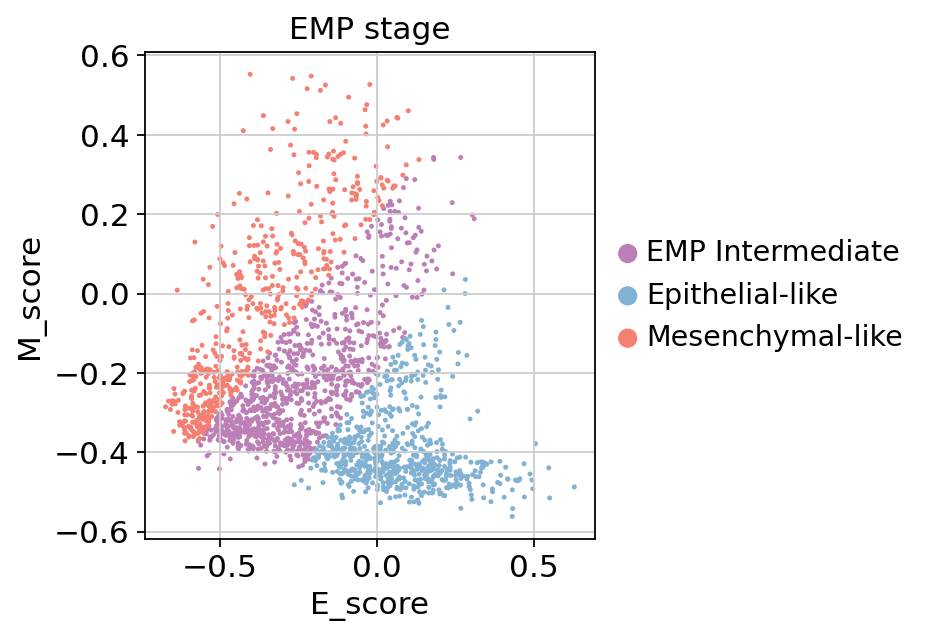

In [46]:
sc.pl.scatter(adata_procssed, x='E_score',y='M_score',color='EMP_stage',size=20)

In [47]:
adata_procssed.obs = adata_procssed.obs.drop(columns=['dissociation_method', 'row', 'column','ranking_ID'])

In [48]:
adata_procssed.obs = adata_procssed.obs.rename(columns={"batch": "sequencing_batch"})

In [49]:
adata_procssed

AnnData object with n_obs × n_vars = 2090 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

In [50]:
adata_procssed.write_h5ad('anndata/SS2_processed.h5ad')

# Individual Tumor

## HCI005

In [51]:
adata_HCI005 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'HCI005']

In [52]:
adata_HCI005

View of AnnData object with n_obs × n_vars = 278 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

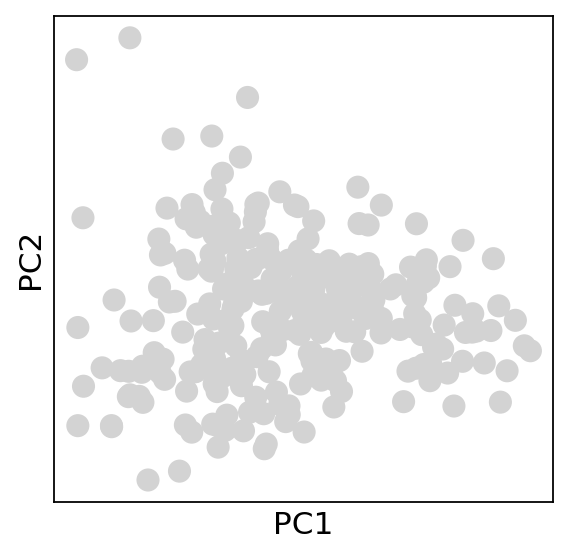

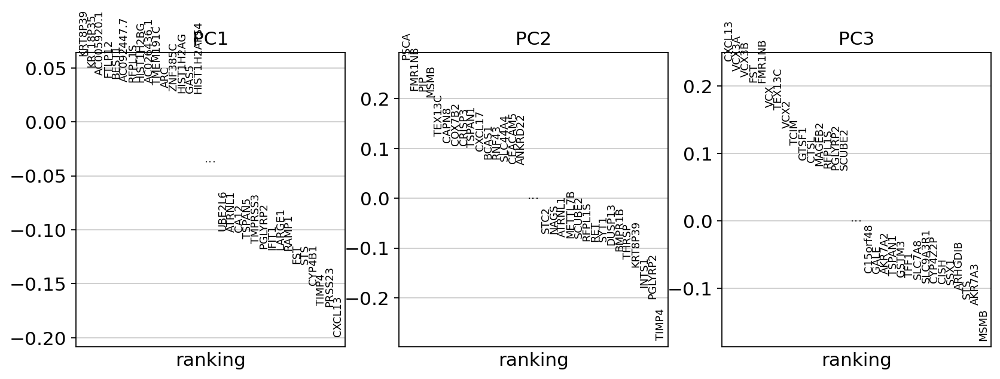

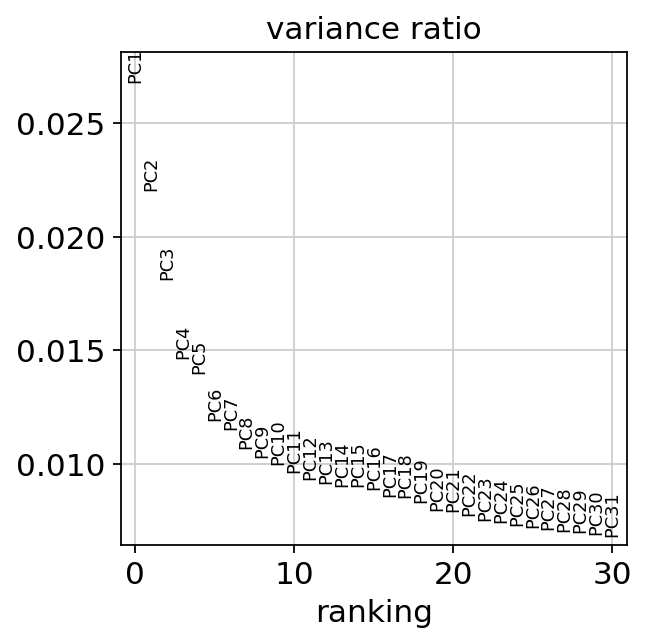

In [53]:
sc.tl.pca(adata_HCI005, svd_solver='auto')
sc.pl.pca_overview(adata_HCI005)

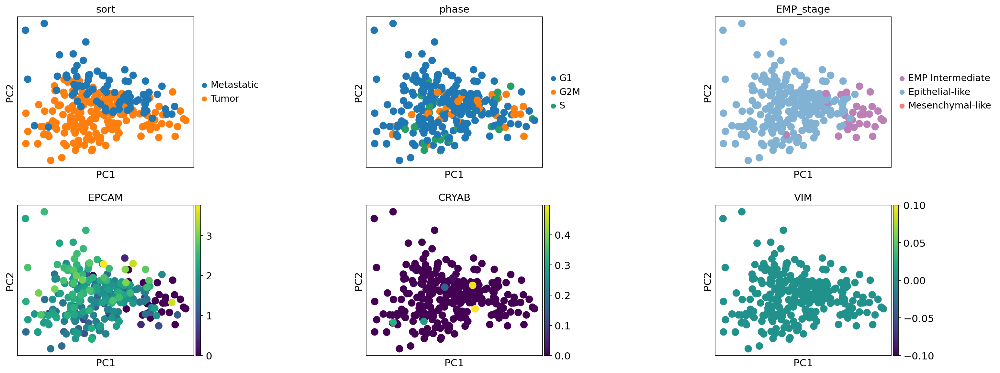

In [54]:
sc.pl.pca(adata_HCI005, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [55]:
sc.pp.neighbors(adata_HCI005, n_neighbors=15, n_pcs=20)
sc.tl.louvain(adata_HCI005, resolution = .5)
sc.tl.leiden(adata_HCI005, resolution = .5)

In [56]:
sc.tl.umap(adata_HCI005)

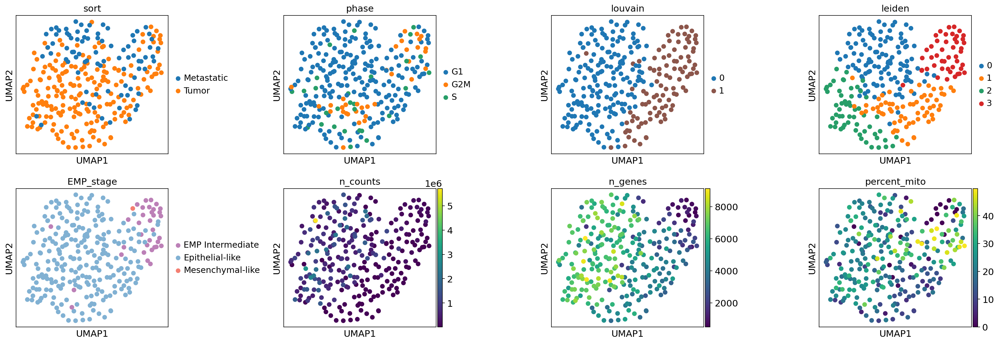

In [57]:
sc.pl.umap(adata_HCI005, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

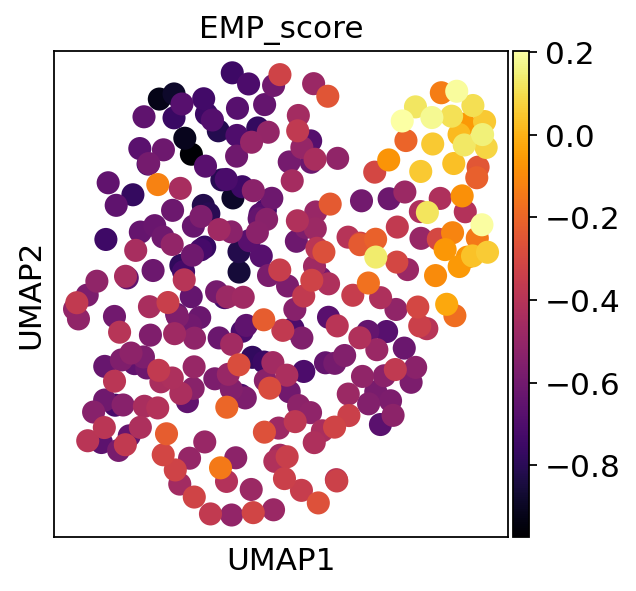

In [58]:
sc.pl.umap(adata_HCI005, color=['EMP_score'],color_map='inferno')

In [59]:
adata_HCI005.write_h5ad('anndata/Individual_Tumor/SS2_HCI005.h5ad')

## H3204

In [60]:
adata_H3204 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'H3204']

In [61]:
adata_H3204

View of AnnData object with n_obs × n_vars = 192 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

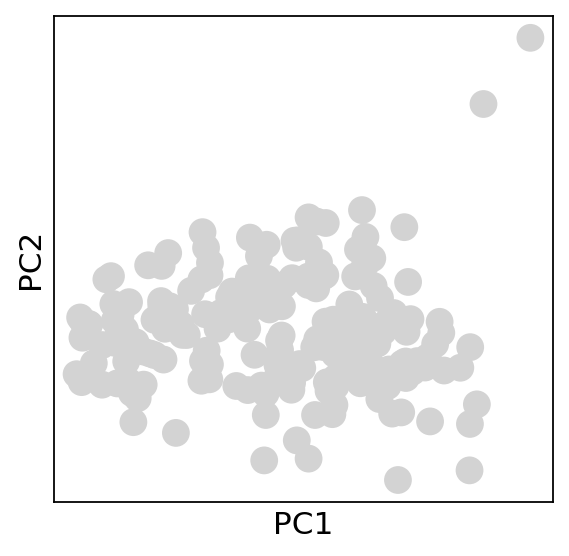

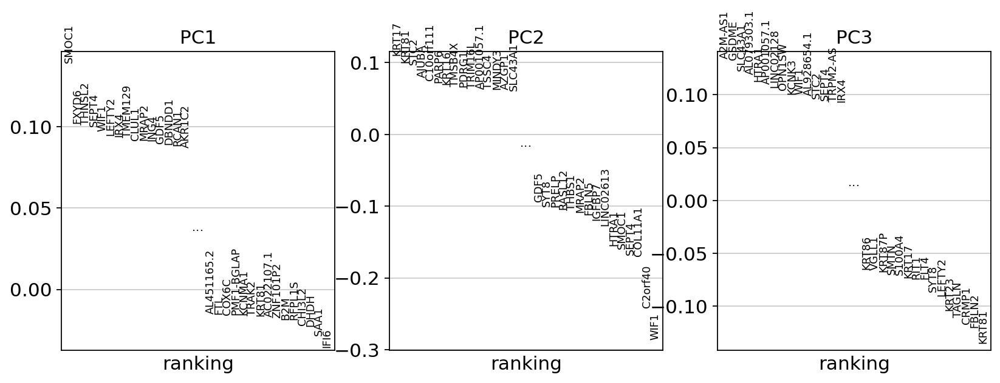

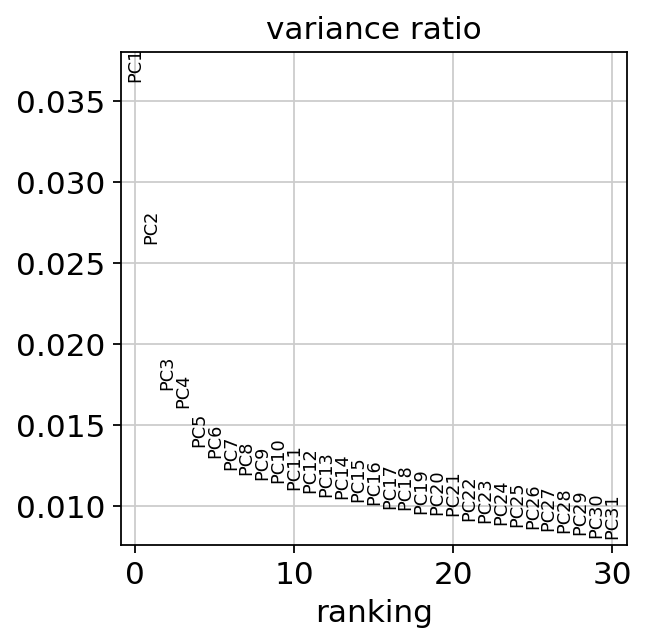

In [62]:
sc.tl.pca(adata_H3204, svd_solver='auto')
sc.pl.pca_overview(adata_H3204)

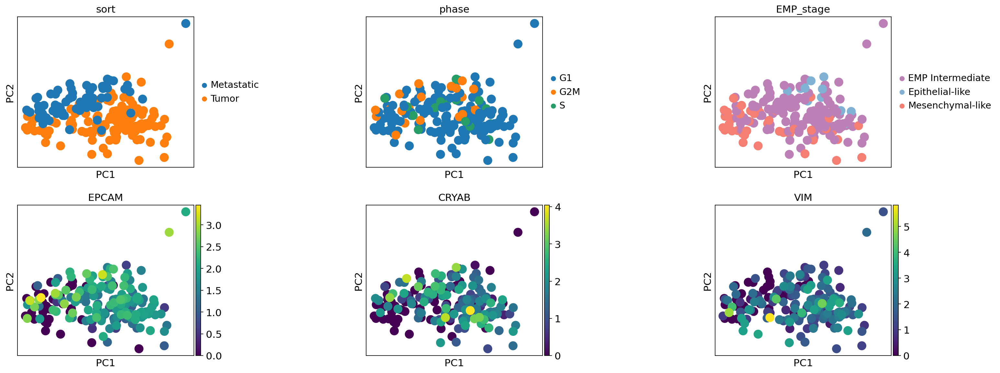

In [63]:
sc.pl.pca(adata_H3204, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [64]:
sc.pp.neighbors(adata_H3204, n_neighbors=15, n_pcs=31)
sc.tl.louvain(adata_H3204, resolution = .5)
sc.tl.leiden(adata_H3204, resolution = .5)

In [65]:
sc.tl.umap(adata_H3204)

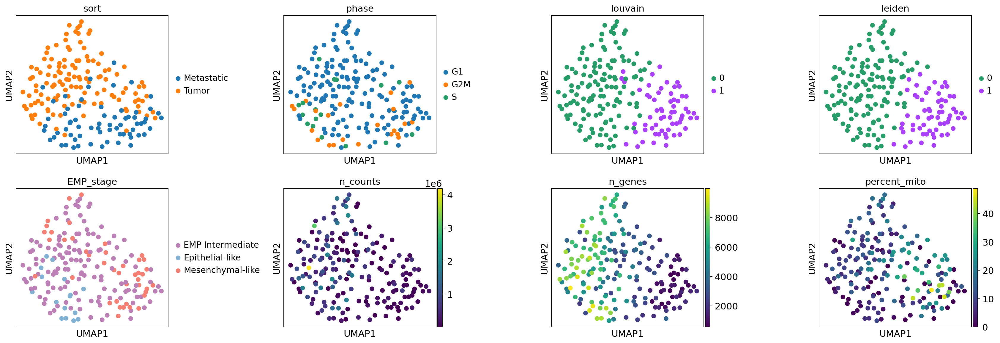

In [66]:
sc.pl.umap(adata_H3204, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

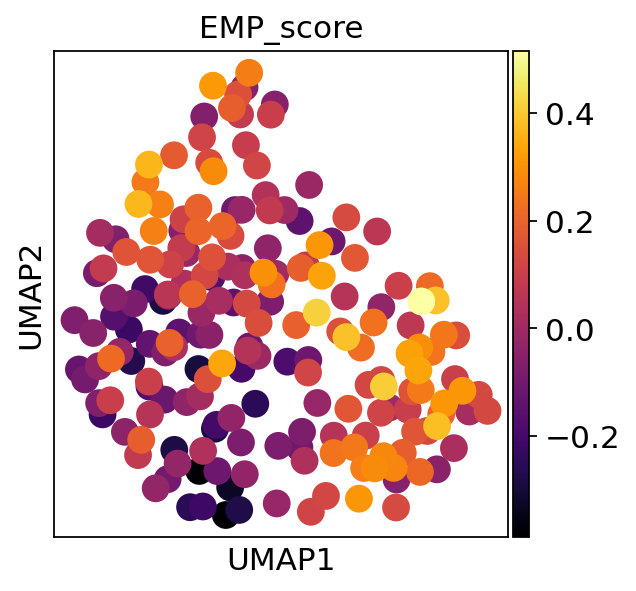

In [67]:
sc.pl.umap(adata_H3204, color=['EMP_score'],color_map='inferno')

In [68]:
adata_H3204.write_h5ad('anndata/Individual_Tumor/SS2_H3204.h5ad')

## H4272

In [69]:
adata_H4272 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'H4272']

In [70]:
adata_H4272

View of AnnData object with n_obs × n_vars = 147 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

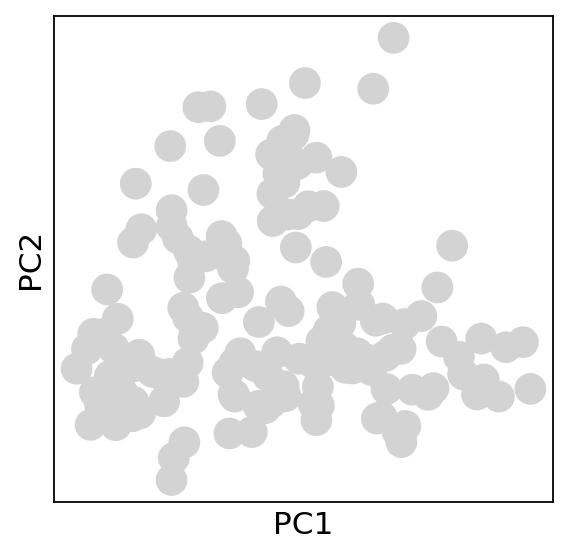

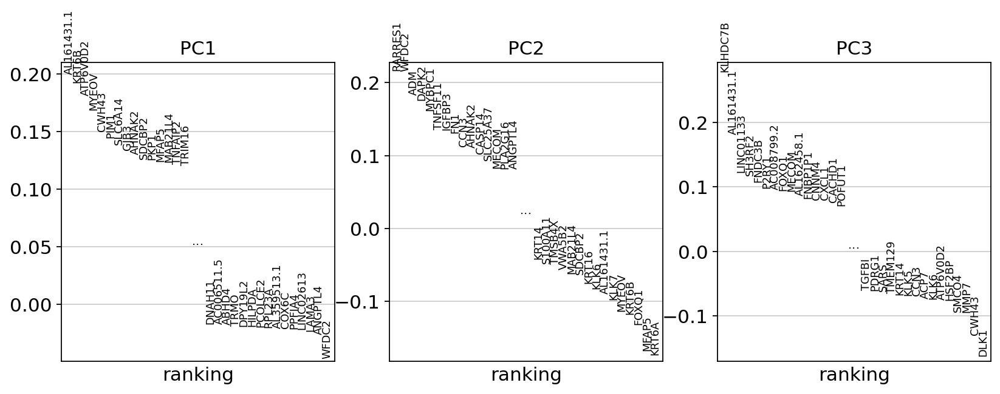

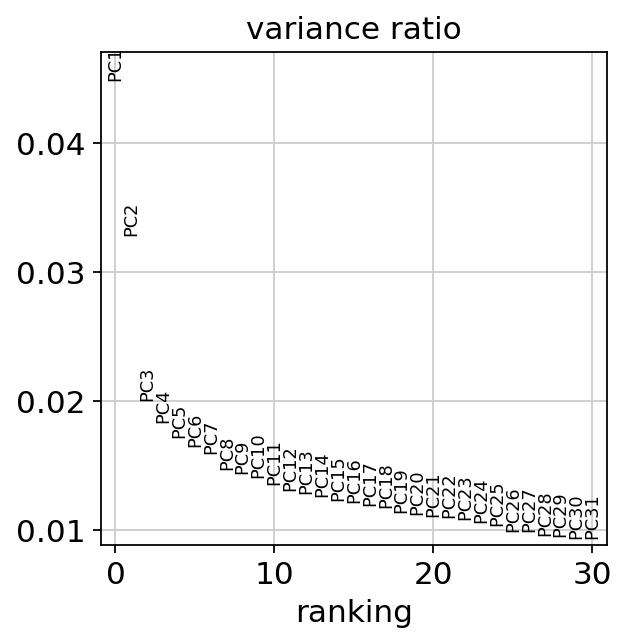

In [71]:
sc.tl.pca(adata_H4272, svd_solver='auto')
sc.pl.pca_overview(adata_H4272)

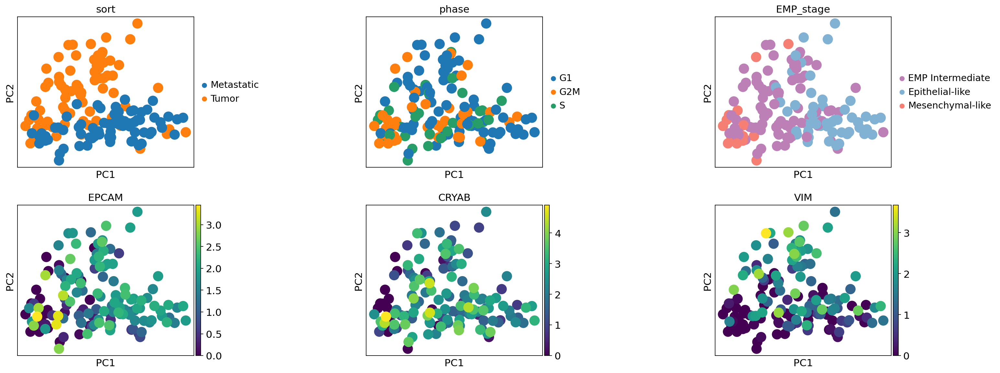

In [72]:
sc.pl.pca(adata_H4272, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [73]:
sc.pp.neighbors(adata_H4272, n_neighbors=15, n_pcs=25)
sc.tl.louvain(adata_H4272, resolution = .5)
sc.tl.leiden(adata_H4272, resolution = .5)

In [74]:
sc.tl.umap(adata_H4272)

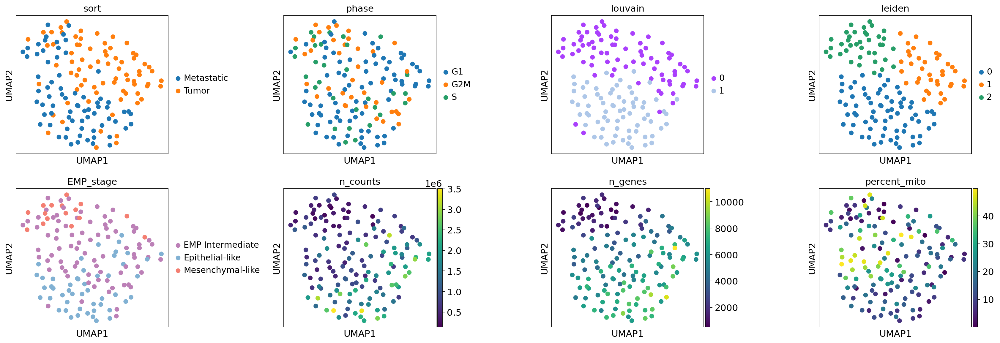

In [75]:
sc.pl.umap(adata_H4272, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

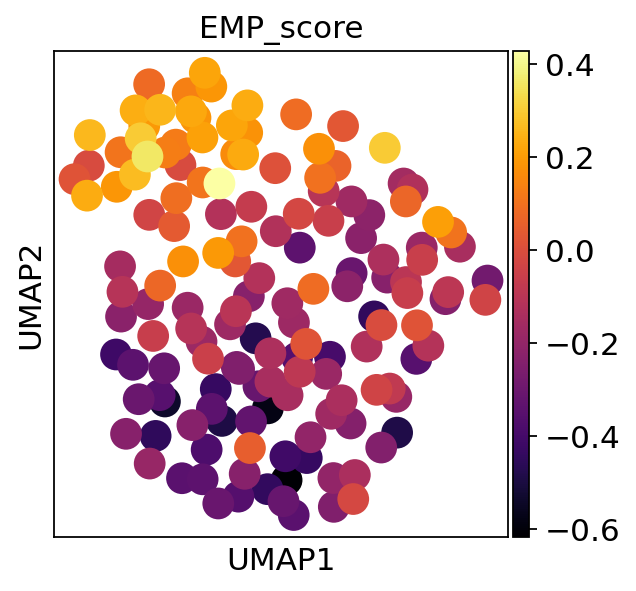

In [76]:
sc.pl.umap(adata_H4272, color=['EMP_score'],color_map='inferno')

In [77]:
adata_H4272.write_h5ad('anndata/Individual_Tumor/SS2_H4272.h5ad')

## J55454

In [78]:
adata_J55454 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'J55454']

In [79]:
adata_J55454

View of AnnData object with n_obs × n_vars = 57 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

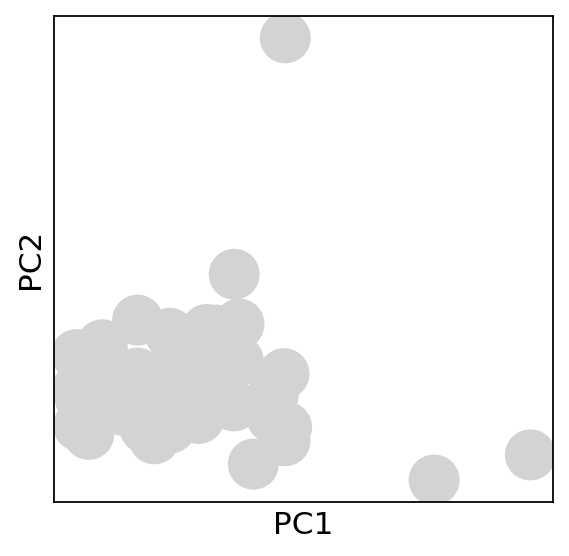

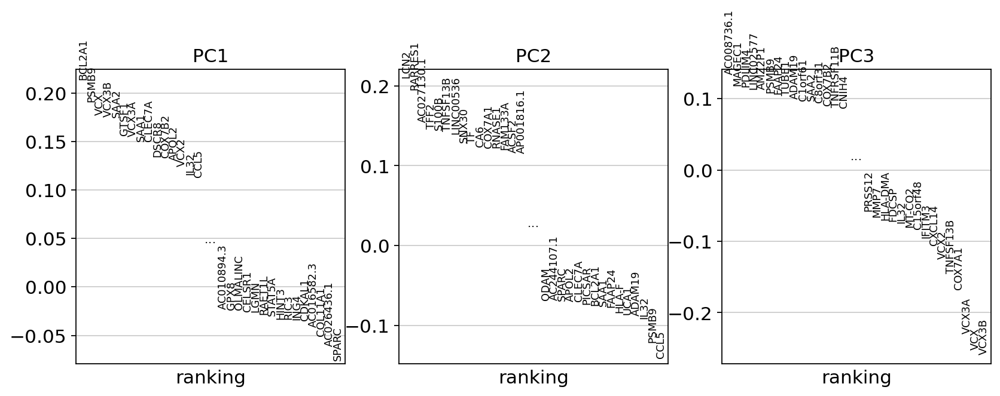

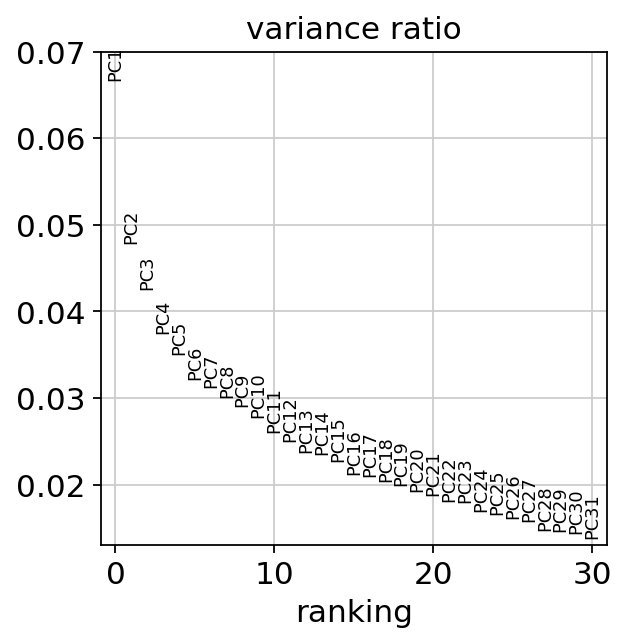

In [80]:
sc.tl.pca(adata_J55454, svd_solver='auto')
sc.pl.pca_overview(adata_J55454)

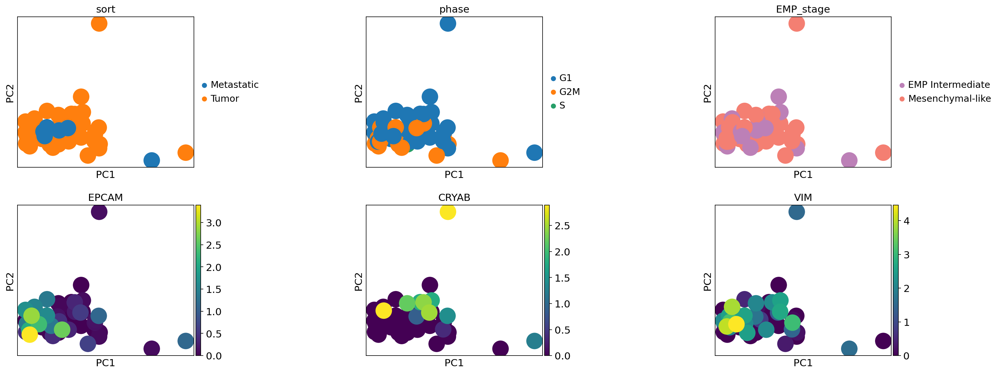

In [81]:
sc.pl.pca(adata_J55454, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [82]:
sc.pp.neighbors(adata_J55454, n_neighbors=15, n_pcs=28)
sc.tl.louvain(adata_J55454, resolution = .5)
sc.tl.leiden(adata_J55454, resolution = .5)

In [83]:
sc.tl.umap(adata_J55454)

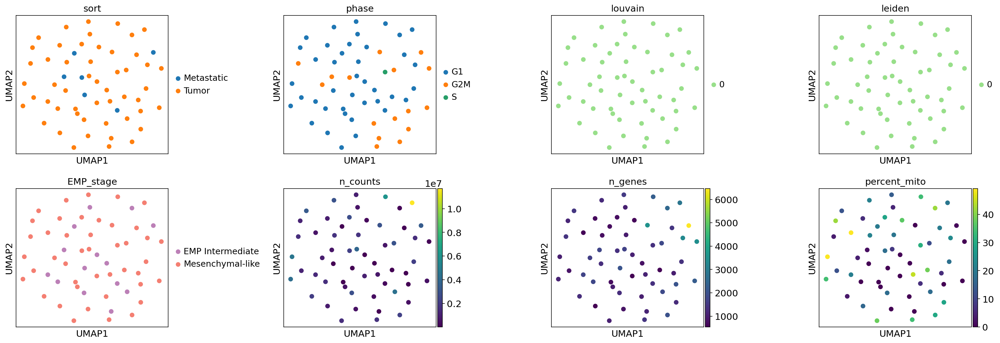

In [84]:
sc.pl.umap(adata_J55454, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

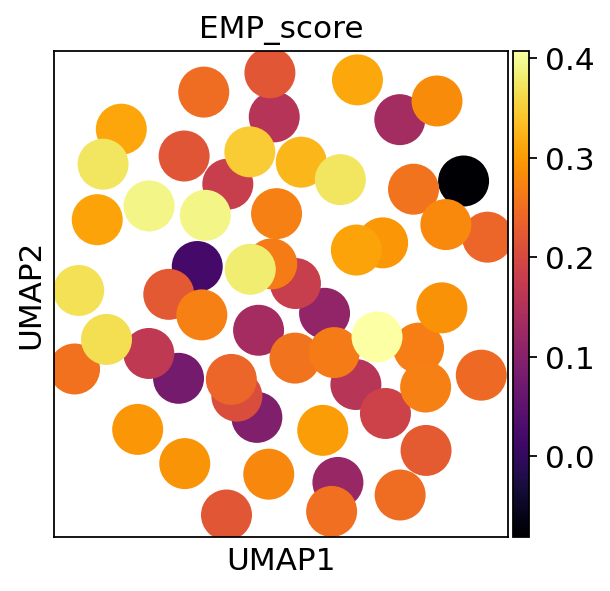

In [85]:
sc.pl.umap(adata_J55454, color=['EMP_score'],color_map='inferno')

In [86]:
adata_J55454.write_h5ad('anndata/Individual_Tumor/SS2_J55454.h5ad')

## H5471

In [87]:
adata_H5471 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'H5471']

In [88]:
adata_H5471

View of AnnData object with n_obs × n_vars = 259 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

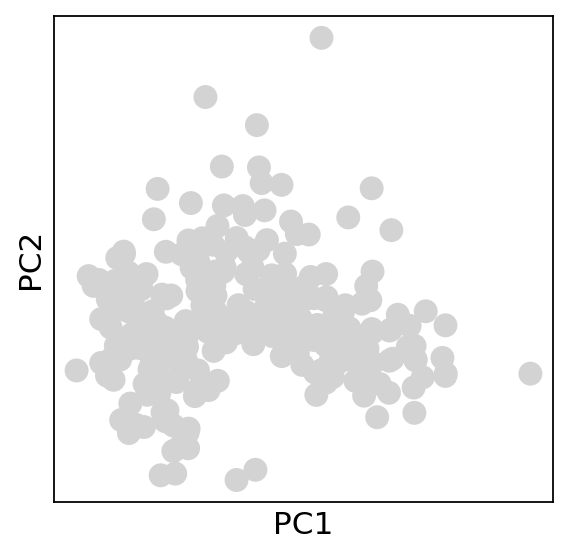

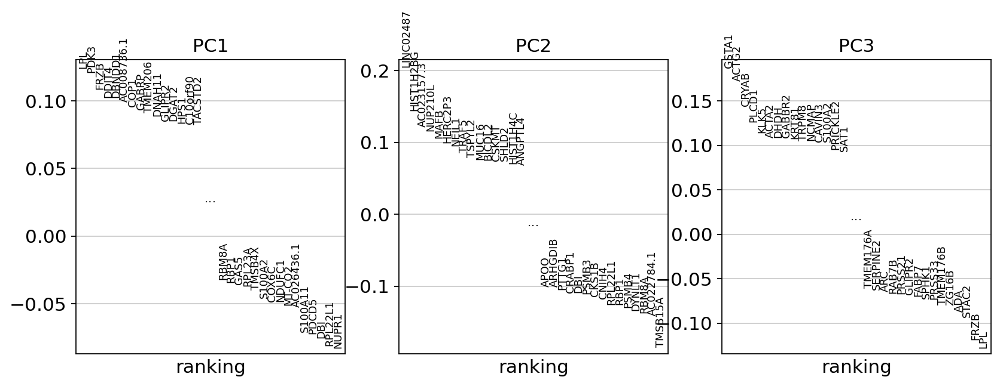

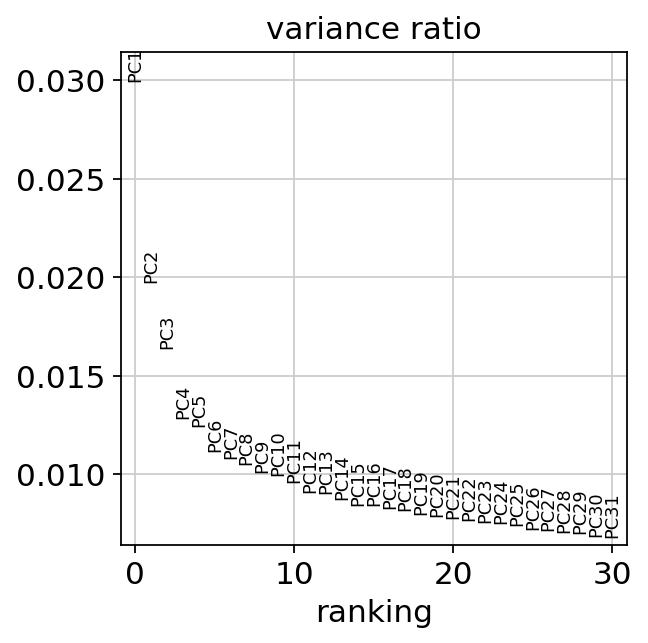

In [89]:
sc.tl.pca(adata_H5471, svd_solver='auto')
sc.pl.pca_overview(adata_H5471)

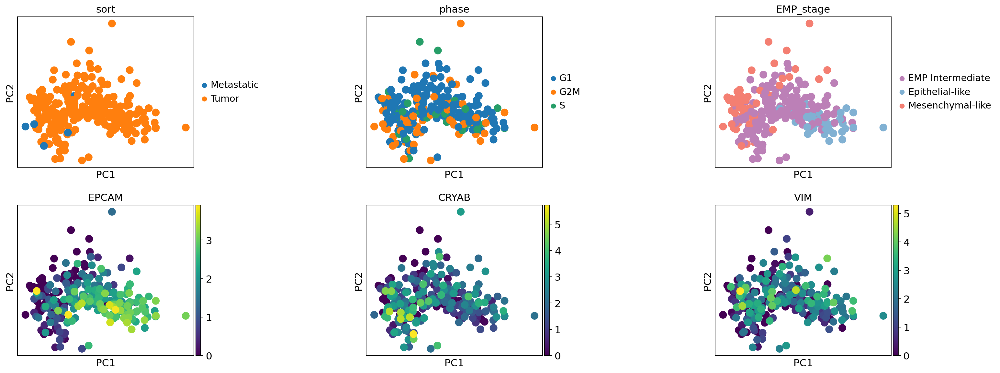

In [90]:
sc.pl.pca(adata_H5471, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [91]:
sc.pp.neighbors(adata_H5471, n_neighbors=15, n_pcs=30)
sc.tl.louvain(adata_H5471, resolution = .5)
sc.tl.leiden(adata_H5471, resolution = .5)

In [92]:
sc.tl.umap(adata_H5471)

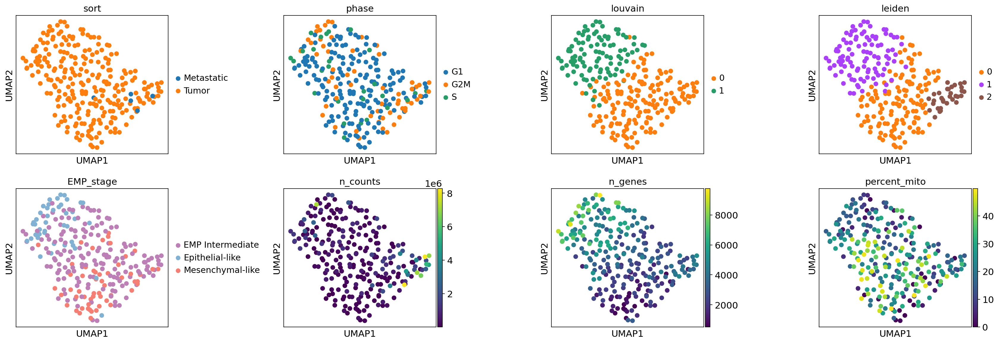

In [93]:
sc.pl.umap(adata_H5471, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

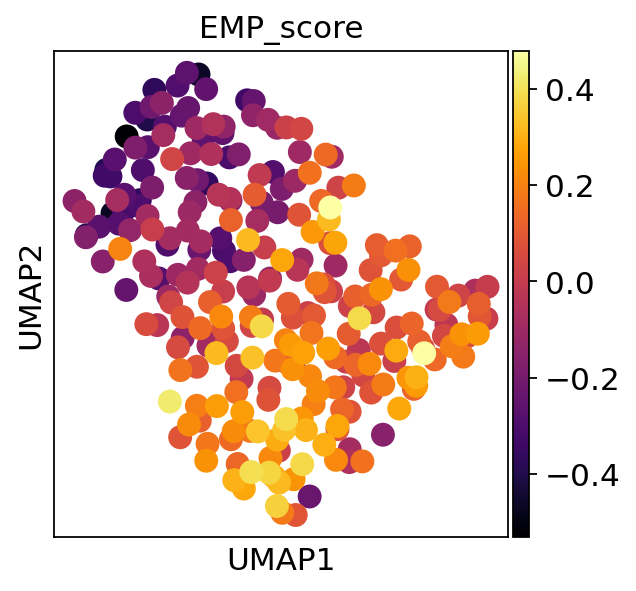

In [94]:
sc.pl.umap(adata_H5471, color=['EMP_score'],color_map='inferno')

In [95]:
adata_H5471.write_h5ad('anndata/Individual_Tumor/SS2_H5471.h5ad')

## HCI009

In [96]:
adata_HCI009 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'HCI009']

In [97]:
adata_HCI009

View of AnnData object with n_obs × n_vars = 67 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

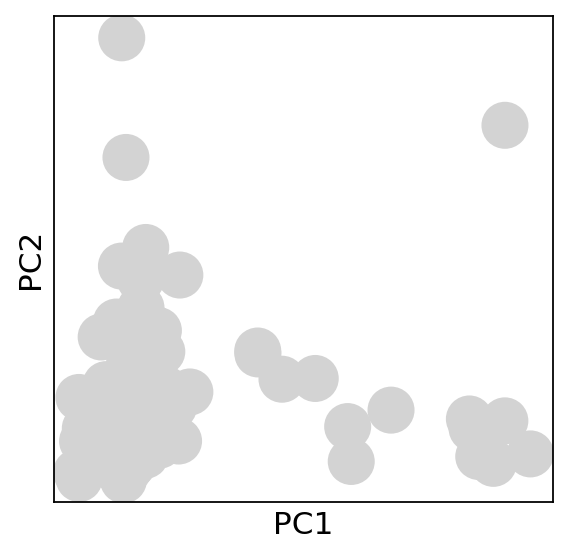

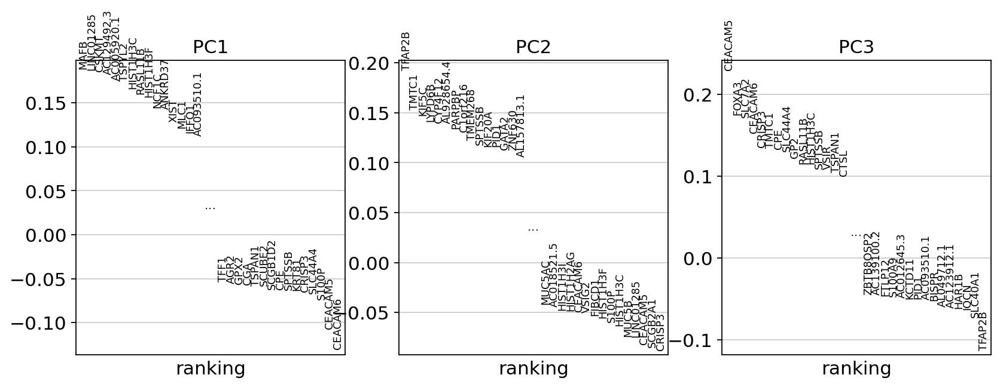

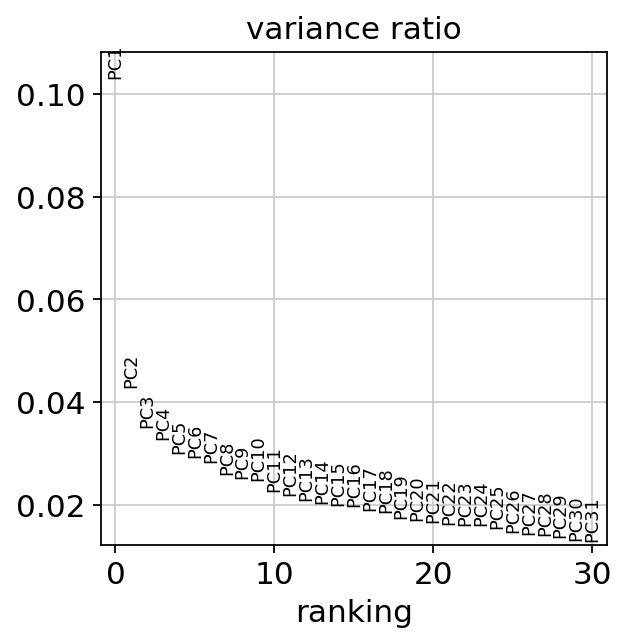

In [98]:
sc.tl.pca(adata_HCI009, svd_solver='auto')
sc.pl.pca_overview(adata_HCI009)

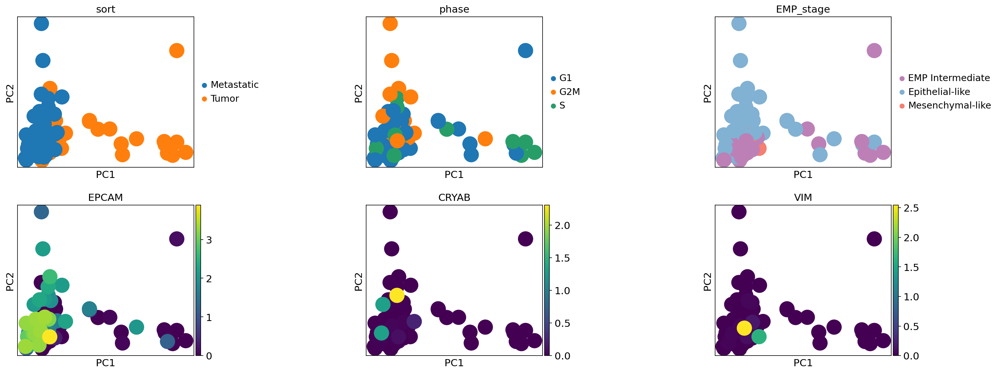

In [99]:
sc.pl.pca(adata_HCI009, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [100]:
sc.pp.neighbors(adata_HCI009, n_neighbors=15, n_pcs=19)
sc.tl.louvain(adata_HCI009, resolution = .5)
sc.tl.leiden(adata_HCI009, resolution = .5)

In [101]:
sc.tl.umap(adata_HCI009)

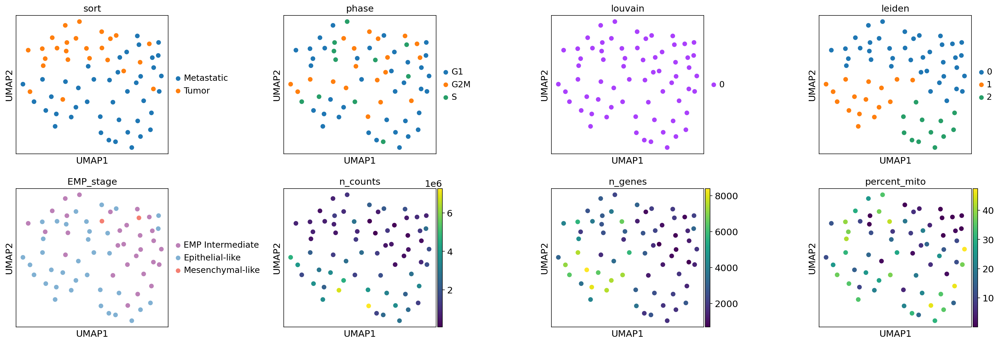

In [102]:
sc.pl.umap(adata_HCI009, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

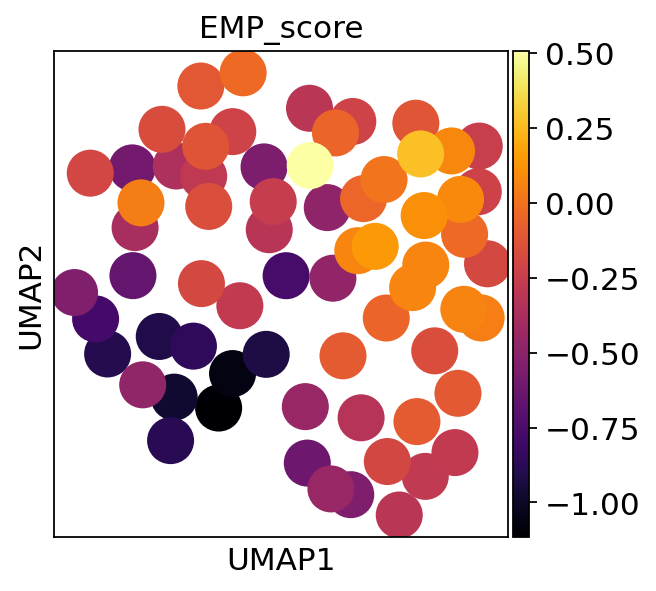

In [103]:
sc.pl.umap(adata_HCI009, color=['EMP_score'],color_map='inferno')

In [104]:
adata_HCI009.write_h5ad('anndata/Individual_Tumor/SS2_HCI009.h5ad')

## HCI011

In [105]:
adata_HCI011 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'HCI011']

In [106]:
adata_HCI011

View of AnnData object with n_obs × n_vars = 217 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

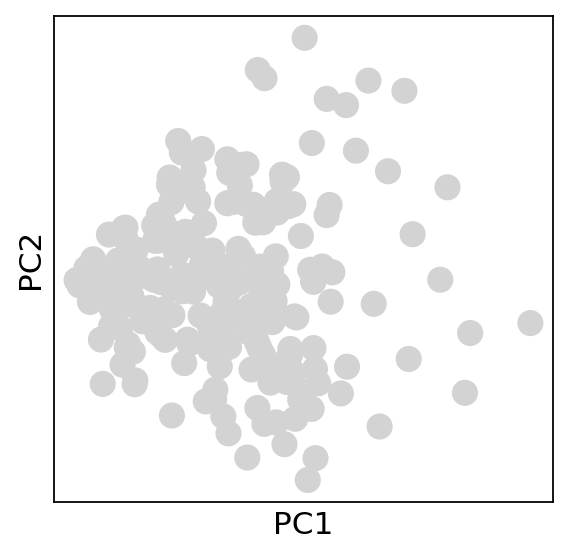

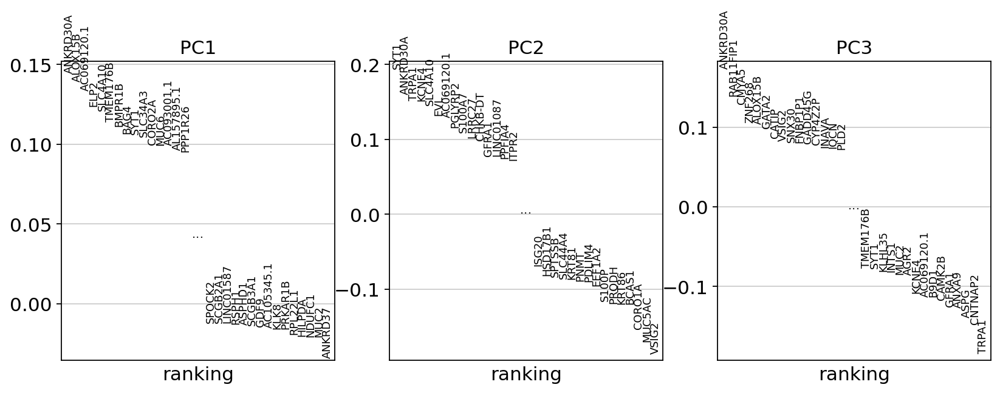

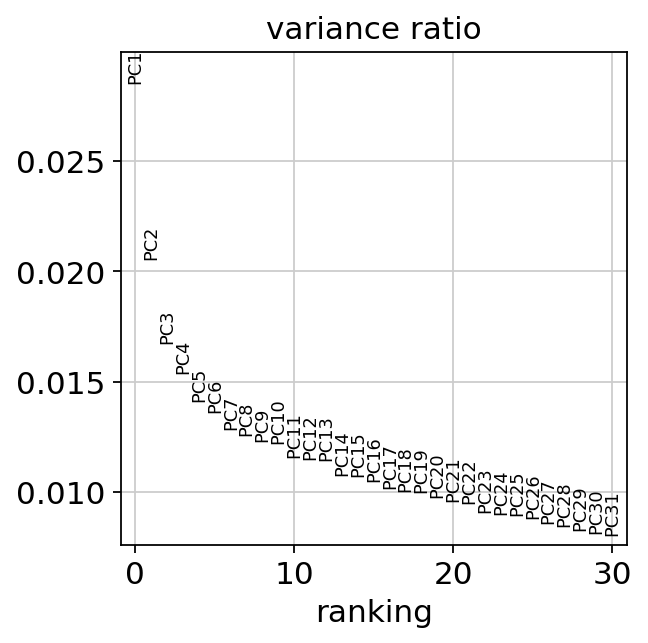

In [107]:
sc.tl.pca(adata_HCI011, svd_solver='auto')
sc.pl.pca_overview(adata_HCI011)

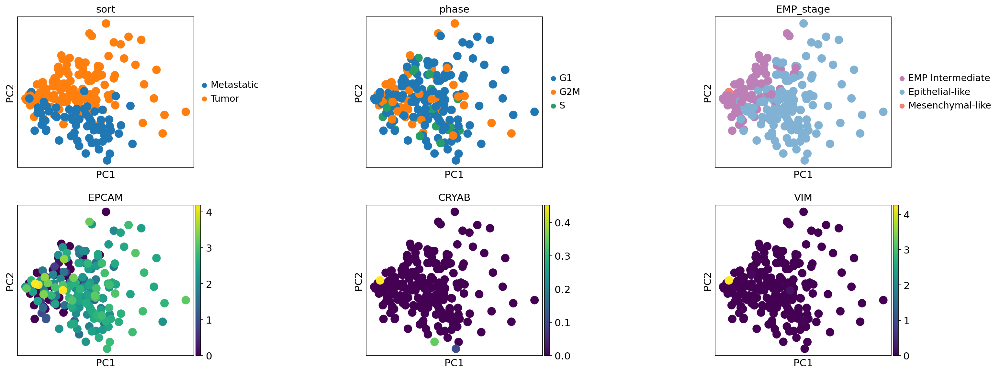

In [108]:
sc.pl.pca(adata_HCI011, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [109]:
sc.pp.neighbors(adata_HCI011, n_neighbors=15, n_pcs=31)
sc.tl.louvain(adata_HCI011, resolution = .5)
sc.tl.leiden(adata_HCI011, resolution = .5)

In [110]:
sc.tl.umap(adata_HCI011)

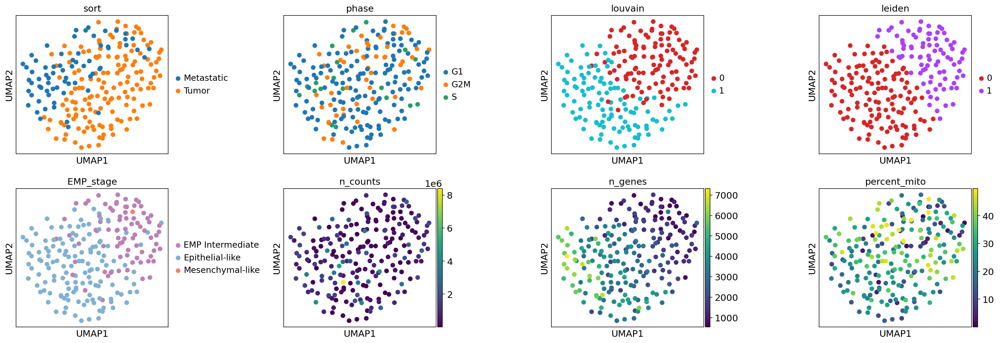

In [111]:
sc.pl.umap(adata_HCI011, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

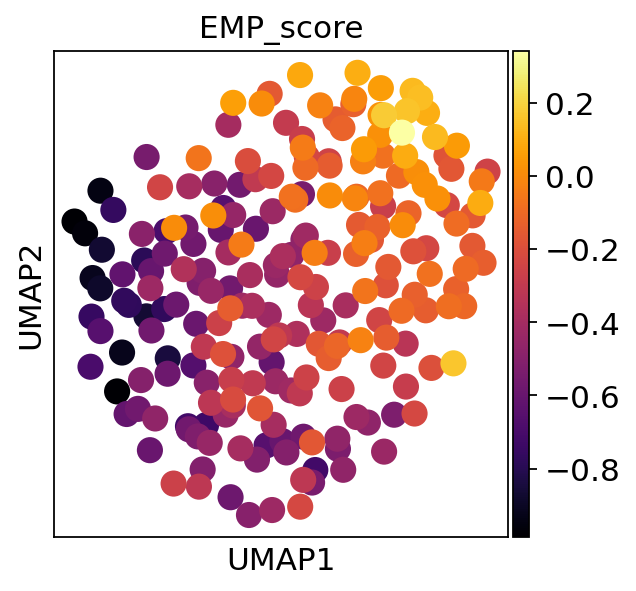

In [112]:
sc.pl.umap(adata_HCI011, color=['EMP_score'],color_map='inferno')

In [113]:
adata_HCI011.write_h5ad('anndata/Individual_Tumor/SS2_HCI011.h5ad')

## HCI001

In [114]:
adata_HCI001 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'HCI001']

In [115]:
adata_HCI001

View of AnnData object with n_obs × n_vars = 154 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

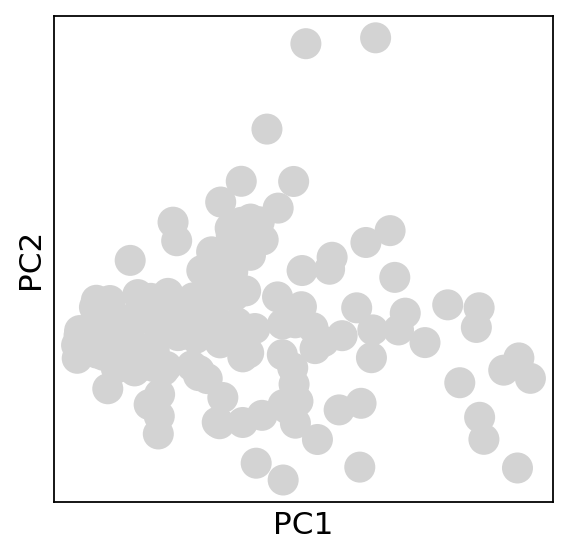

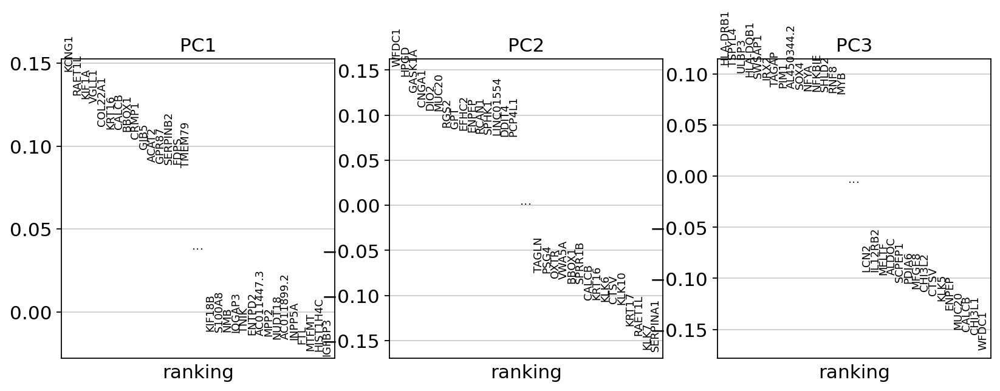

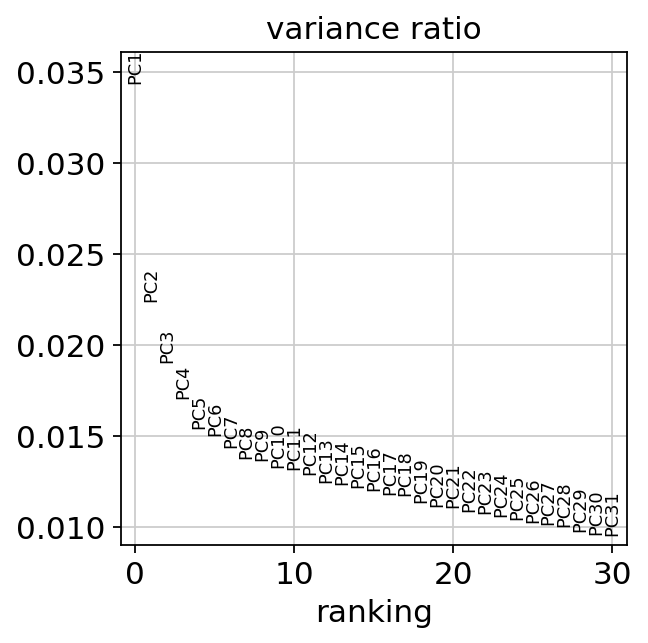

In [116]:
sc.tl.pca(adata_HCI001, svd_solver='auto')
sc.pl.pca_overview(adata_HCI001)

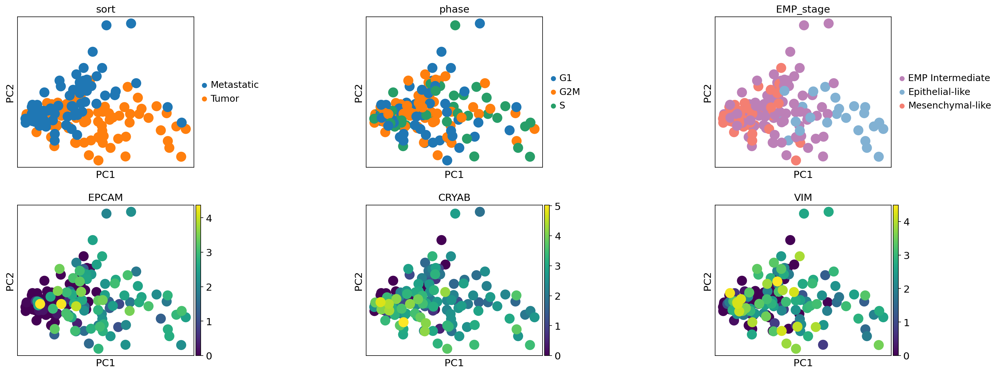

In [117]:
sc.pl.pca(adata_HCI001, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [118]:
sc.pp.neighbors(adata_HCI001, n_neighbors=15, n_pcs=30)
sc.tl.louvain(adata_HCI001, resolution = .5)
sc.tl.leiden(adata_HCI001, resolution = .5)

In [119]:
sc.tl.umap(adata_HCI001)

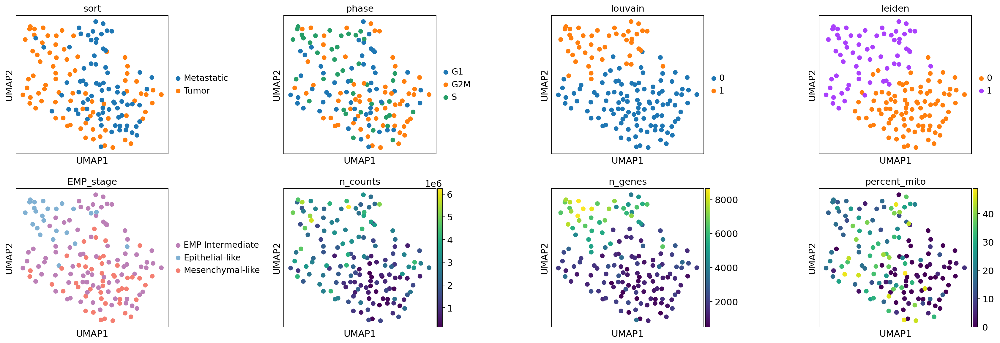

In [120]:
sc.pl.umap(adata_HCI001, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

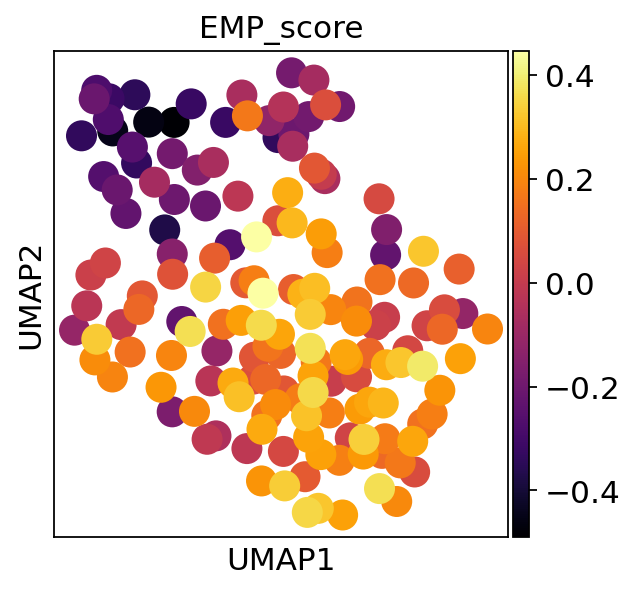

In [121]:
sc.pl.umap(adata_HCI001, color=['EMP_score'],color_map='inferno')

In [122]:
adata_HCI001.write_h5ad('anndata/Individual_Tumor/SS2_HCI001.h5ad')

## H5097

In [123]:
adata_H5097 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'H5097']

In [124]:
adata_H5097

View of AnnData object with n_obs × n_vars = 200 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

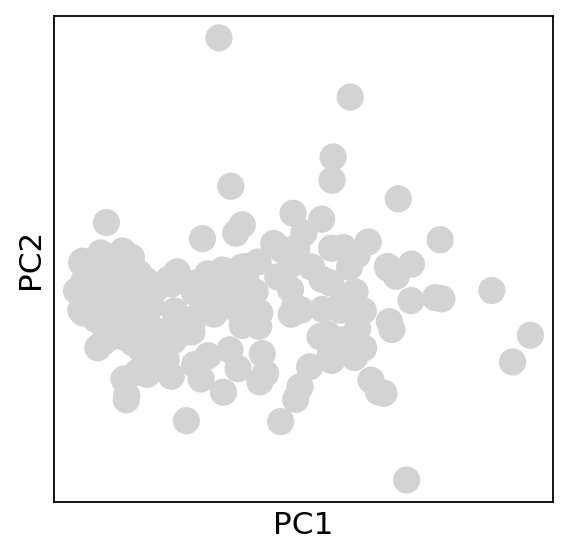

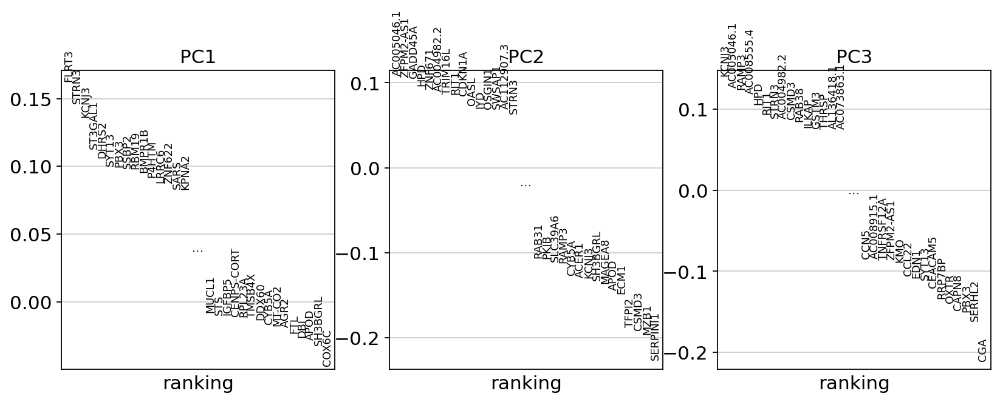

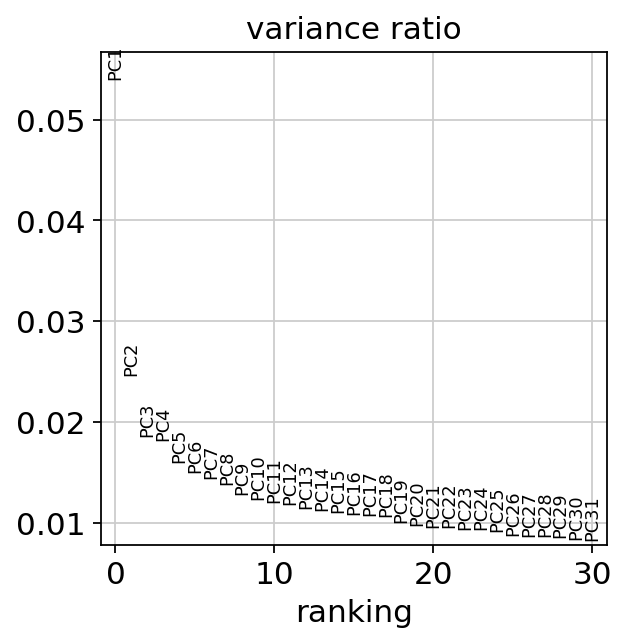

In [125]:
sc.tl.pca(adata_H5097, svd_solver='auto')
sc.pl.pca_overview(adata_H5097)

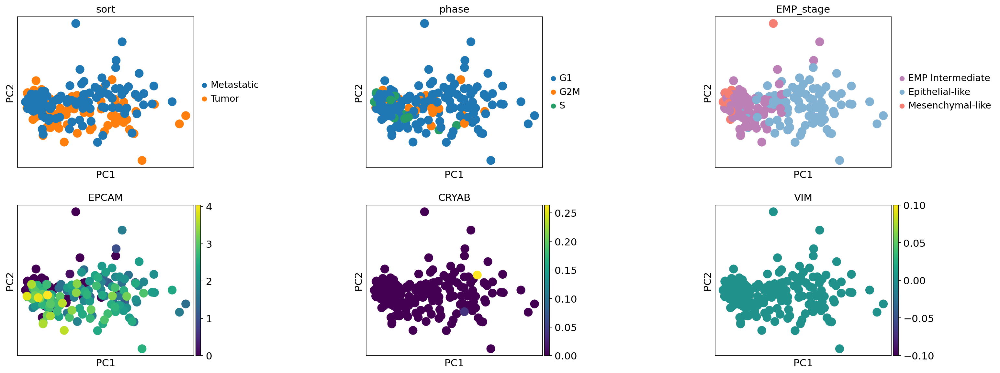

In [126]:
sc.pl.pca(adata_H5097, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [127]:
sc.pp.neighbors(adata_H5097, n_neighbors=15, n_pcs=20)
sc.tl.louvain(adata_H5097, resolution = .5)
sc.tl.leiden(adata_H5097, resolution = .5)

In [128]:
sc.tl.umap(adata_H5097)

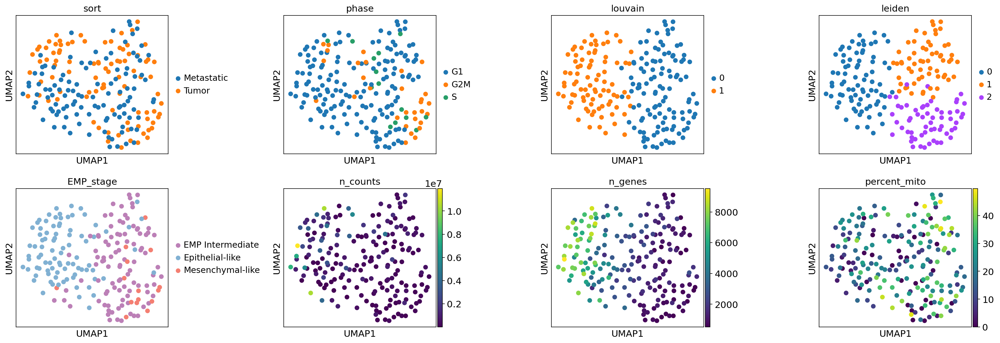

In [129]:
sc.pl.umap(adata_H5097, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

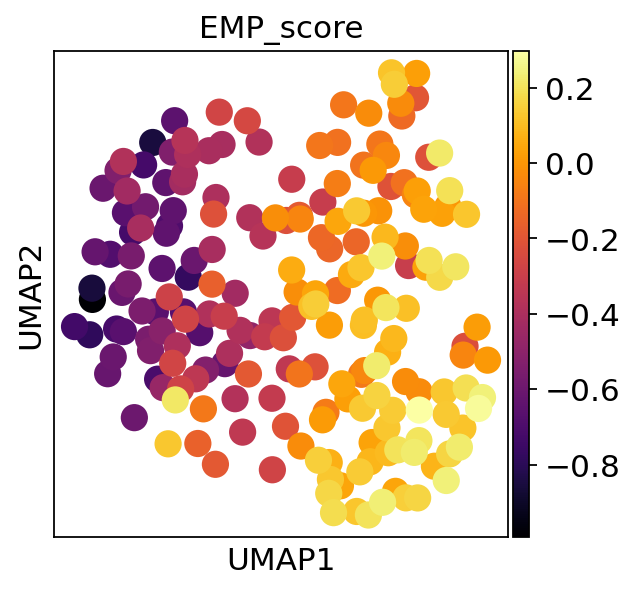

In [130]:
sc.pl.umap(adata_H5097, color=['EMP_score'],color_map='inferno')

In [131]:
adata_H5097.write_h5ad('anndata/Individual_Tumor/SS2_H5097.h5ad')

## J2036

In [132]:
adata_J2036 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'J2036']

In [133]:
adata_J2036

View of AnnData object with n_obs × n_vars = 142 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

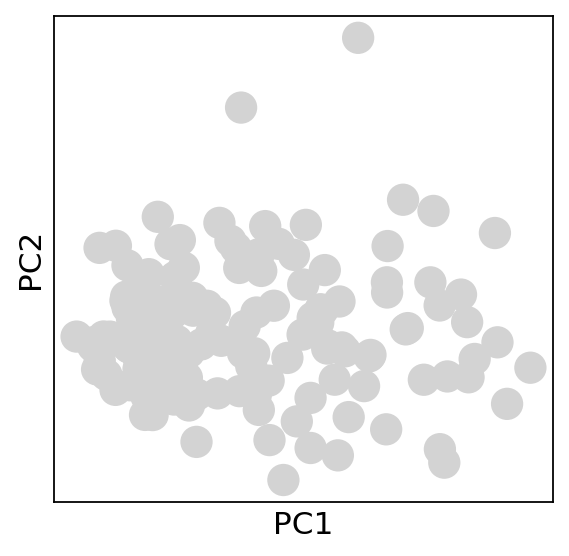

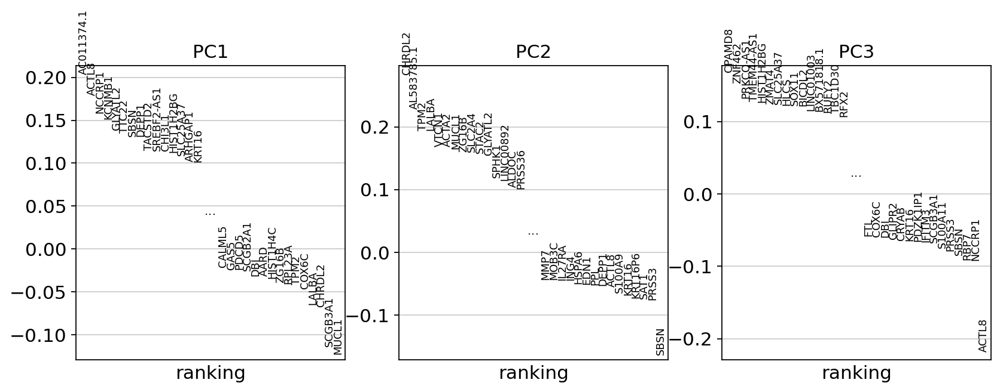

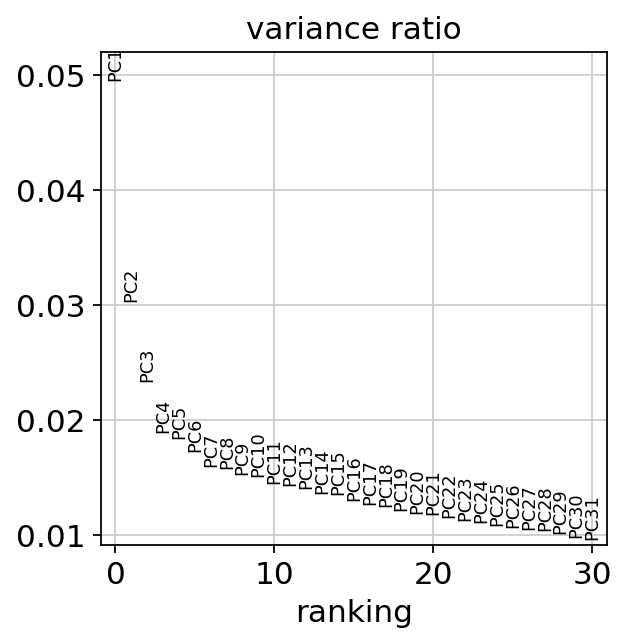

In [134]:
sc.tl.pca(adata_J2036, svd_solver='auto')
sc.pl.pca_overview(adata_J2036)

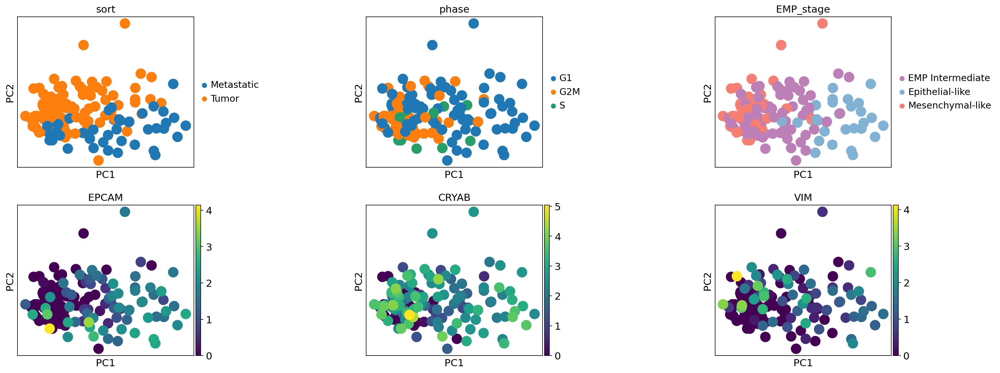

In [135]:
sc.pl.pca(adata_J2036, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [136]:
sc.pp.neighbors(adata_J2036, n_neighbors=15, n_pcs=25)
sc.tl.louvain(adata_J2036, resolution = .5)
sc.tl.leiden(adata_J2036, resolution = .5)

In [137]:
sc.tl.umap(adata_J2036)

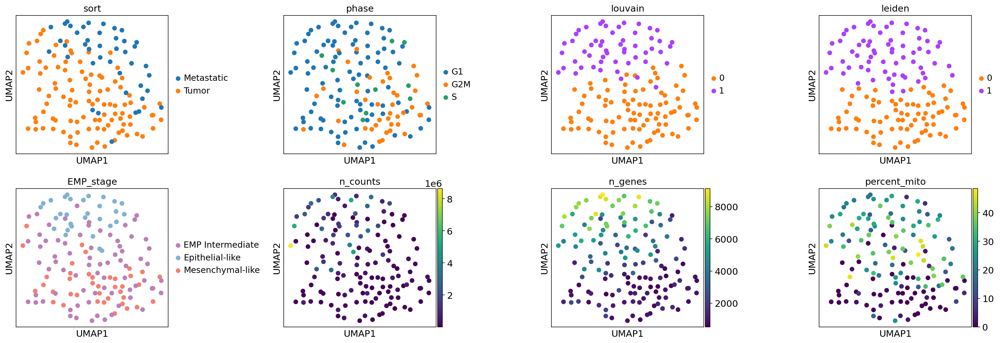

In [138]:
sc.pl.umap(adata_J2036, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

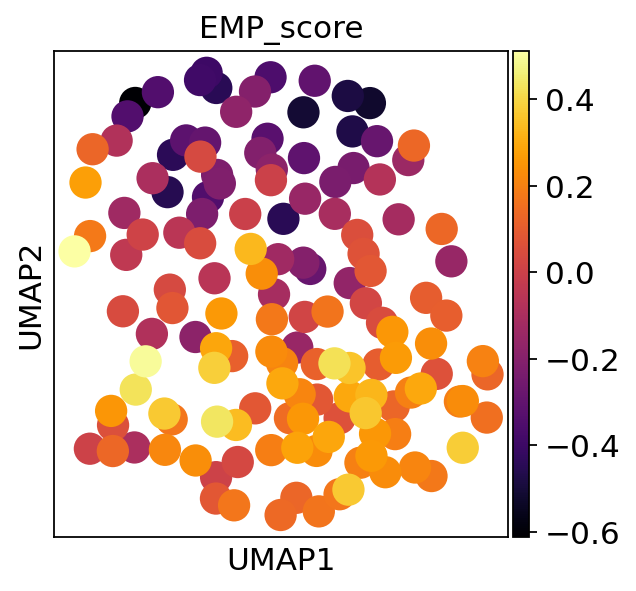

In [139]:
sc.pl.umap(adata_J2036, color=['EMP_score'],color_map='inferno')

In [140]:
adata_J2036.write_h5ad('anndata/Individual_Tumor/SS2_J2036.h5ad')

## J53353

In [141]:
adata_J53353 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'J53353']

In [142]:
adata_J53353

View of AnnData object with n_obs × n_vars = 149 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

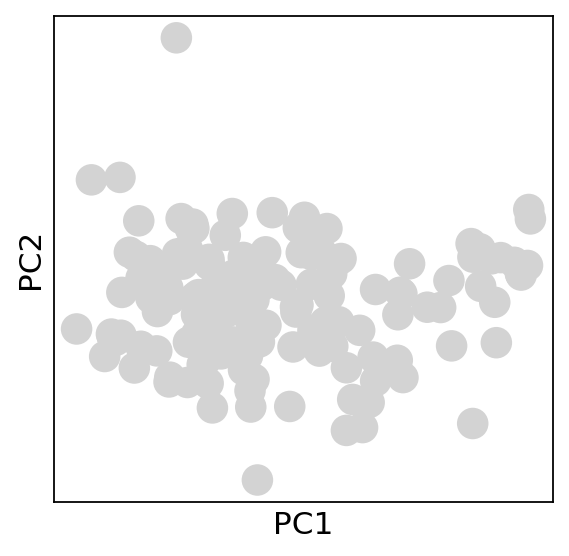

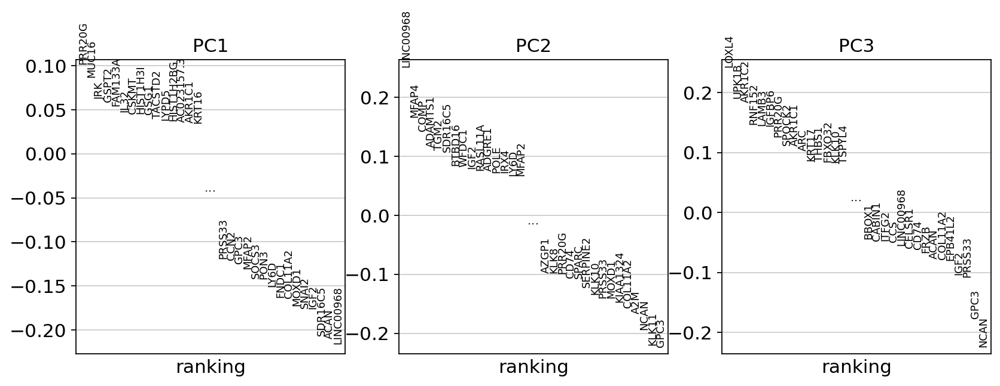

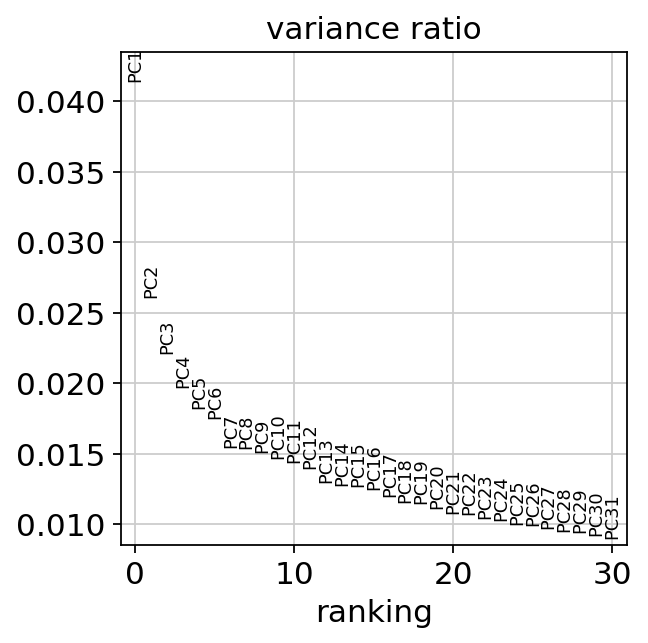

In [143]:
sc.tl.pca(adata_J53353, svd_solver='auto')
sc.pl.pca_overview(adata_J53353)

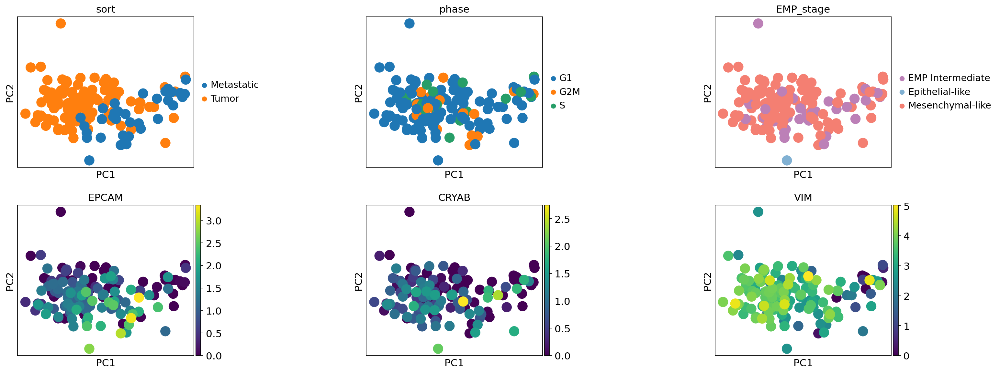

In [144]:
sc.pl.pca(adata_J53353, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [145]:
sc.pp.neighbors(adata_J53353, n_neighbors=15, n_pcs=28)
sc.tl.louvain(adata_J53353, resolution = .5)
sc.tl.leiden(adata_J53353, resolution = .5)

In [146]:
sc.tl.umap(adata_J53353)

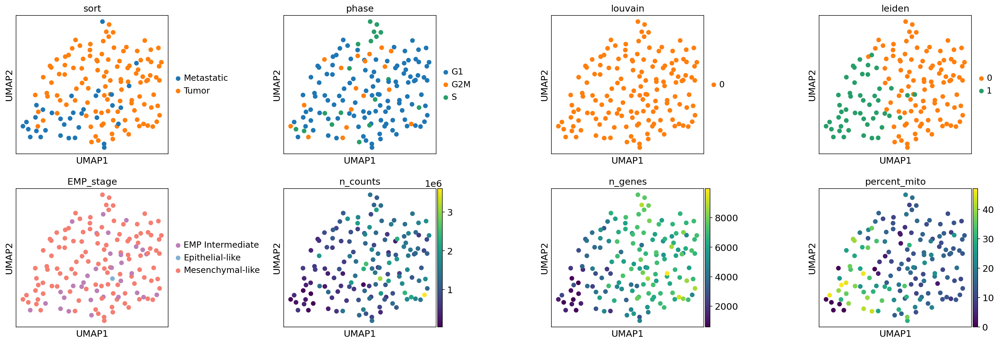

In [147]:
sc.pl.umap(adata_J53353, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

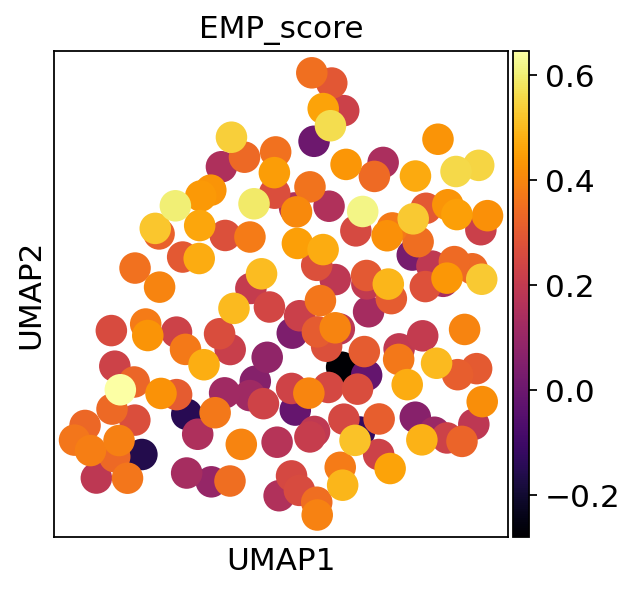

In [148]:
sc.pl.umap(adata_J53353, color=['EMP_score'],color_map='inferno')

In [149]:
adata_J53353.write_h5ad('anndata/Individual_Tumor/SS2_J53353.h5ad')

## HCI010

In [150]:
adata_HCI010 = adata_procssed[adata_procssed.obs['Tumor_ID'] == 'HCI010']

In [151]:
adata_HCI010

View of AnnData object with n_obs × n_vars = 228 × 34041
    obs: 'plate_ID', 'well', 'cell_id', 'Tumor_ID', 'Animal_ID', 'receptor_status', 'ER_receptor', 'intrinsic_BC_type', 'metastatic_potential_rank', 'metastatic_potential_group', 'sort', 'n_counts', 'n_genes', 'percent_ERCC', 'percent_mito', 'percent_ribo', 'sequencing_batch', 'S_score', 'G2M_score', 'phase', 'louvain', 'leiden', 'E_score', 'M_score', 'EMP_score', 'EMP_stage'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'ranking_ID_colors', 'hvg', 'log1p', 'pca', 'Tumor_ID_colors', 'ER_receptor_colors', 'intrinsic_BC_type_colors', 'neighbors', 'louvain', 'leiden', 'umap', 'receptor_status_colors', 'louvain_colors', 'leiden_colors', 'EMP_stage_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'raw_counts', 'log1p'
    obsp: 'distances', 'connectivities'

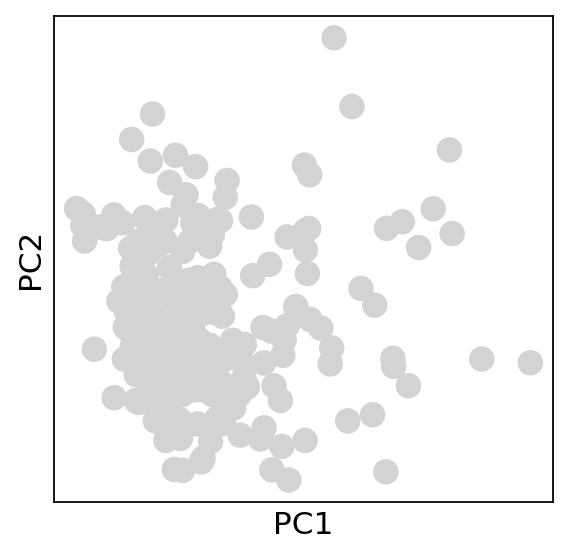

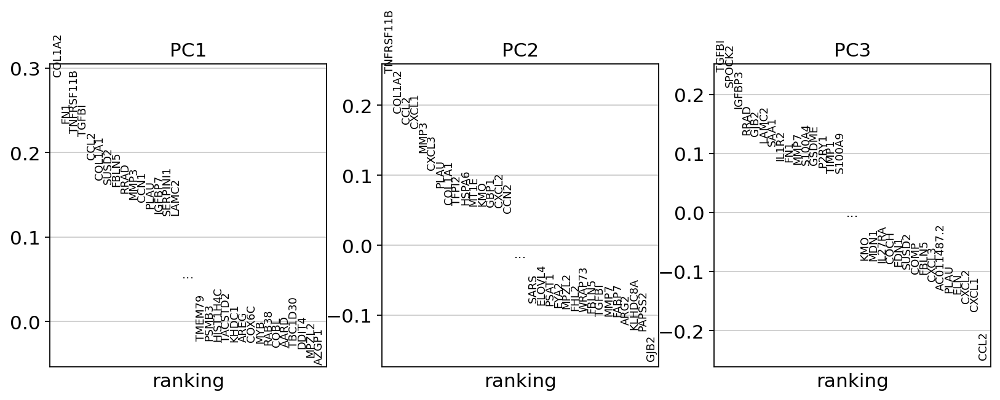

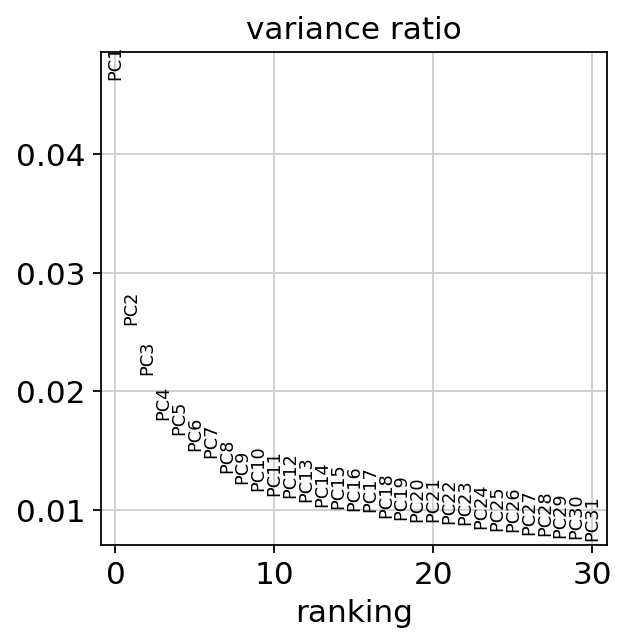

In [152]:
sc.tl.pca(adata_HCI010, svd_solver='auto')
sc.pl.pca_overview(adata_HCI010)

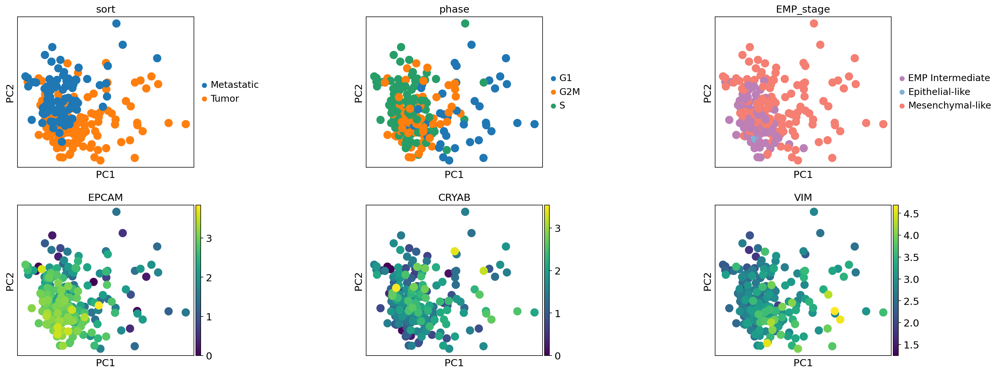

In [153]:
sc.pl.pca(adata_HCI010, color=['sort','phase','EMP_stage','EPCAM','CRYAB','VIM'],wspace=0.8,ncols=3)

In [154]:
sc.pp.neighbors(adata_HCI010, n_neighbors=15, n_pcs=14)
sc.tl.louvain(adata_HCI010, resolution = .5)
sc.tl.leiden(adata_HCI010, resolution = .5)

In [155]:
sc.tl.umap(adata_HCI010)

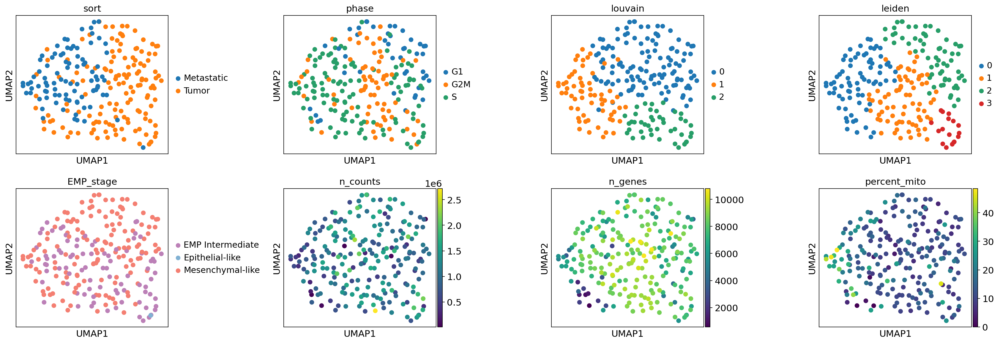

In [156]:
sc.pl.umap(adata_HCI010, color=['sort','phase','louvain','leiden','EMP_stage','n_counts','n_genes','percent_mito'], ncols=4, wspace=0.6,size=200)

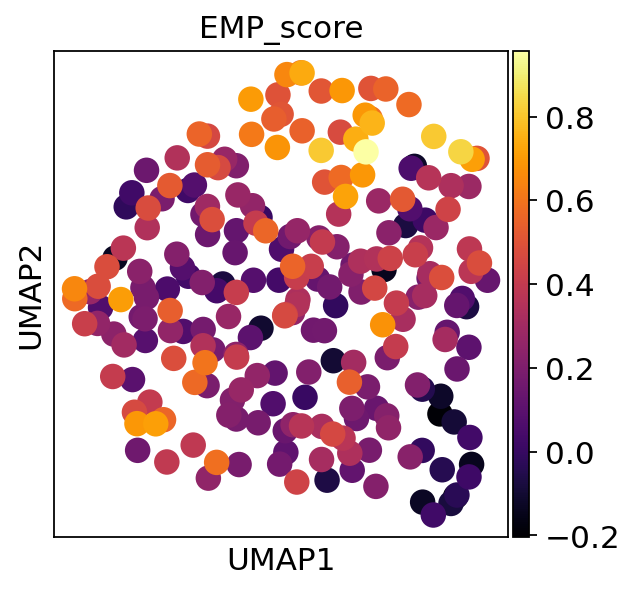

In [157]:
sc.pl.umap(adata_HCI010, color=['EMP_score'],color_map='inferno')

In [158]:
adata_HCI010.write_h5ad('anndata/Individual_Tumor/SS2_HCI010.h5ad')